# MissOh DataLoader

### AnotherMissOh Visual Structure
- json_data['file_name'] : 'AnotherMissOh01.mp4'
- json_data['visual_results']
- json_data['visual_results'][0].keys() : dict_keys(['start_time', 'end_time', 'vid', 'image_info'])
- {
'start_time': '00:02:51;16', 
'end_time': '00:02:54;15', 
'vid': 'AnotherMissOh01_001_0078', 
'image_info': ...}
- json_data['visual_results'][0]['image_info']
- [{'frame_id': 'AnotherMissOh01_001_0078_IMAGE_0000004295', 
'place': 'none', 
'persons': [
{'person_id': 'Haeyoung1', 
'person_info': {
'face_rect': {'min_x': 515, 'min_y': 0, 'max_x': 845, 'max_y': 443}, 
'full_rect': {'min_x': 278, 'min_y': 2, 'max_x': 1025, 'max_y': 769}, 
'behavior': 'stand up', 
'predicate': 'none', 
'emotion': 'Neutral', 
'face_rect_score': '0.5', 
'full_rect_score': '0.9'}, 
'related_objects': []}], 
'objects': []}, 
- {'frame_id': 'AnotherMissOh01_001_0078_IMAGE_0000004311', 
'place': '', 
'persons': [{
'person_id':'Haeyoung1',
'person_info': {
'face_rect': {'min_x': 515, 'min_y': 0, 'max_x': 831, 'max_y': 411}, 
'full_rect': {'min_x': 270, 'min_y': 0, 'max_x': 1025, 'max_y': 768}, 
'behavior': 'stand up', 
'predicate': 'none', 
'emotion': 'Neutral', 
'face_rect_score': '0.5', 
'full_rect_score': '0.9'}, 
'related_objects': []}],
'objects': []},]

In [2]:
# !apt-get install graphviz xdg-utils

In [3]:
import sys, os
sys.path.append("../") # go to parent dir

In [4]:
import os
from torch.utils.data import Dataset, DataLoader
import cv2
import pickle
import numpy as np
import glob
from torchvision.transforms import Compose, Resize, ToTensor, Normalize
from PIL import Image
import json
import argparse
import matplotlib.pyplot as plt

from Yolo_v2_pytorch.src.utils import *
from graphviz import Digraph, Graph

In [5]:
def is_not_blank(s):
    return bool(s and s.strip())

In [6]:
MissOh_CLASSES = ['person']
print(MissOh_CLASSES[0])
global colors
colors = pickle.load(open("../Yolo_v2_pytorch/src/pallete", "rb"))
print(colors[0])

person
(39, 129, 113)


In [7]:
import sys, os
sys.path.append("../") # go to parent dir

In [8]:
import os
import glob
import argparse
import pickle
import cv2
import numpy as np
from Yolo_v2_pytorch.src.utils import *
import torch.nn.functional as F
from torch.utils.data import DataLoader
from Yolo_v2_pytorch.src.yolo_net import Yolo
from Yolo_v2_pytorch.src.anotherMissOh_dataset import AnotherMissOh, Splits, SortFullRect, PersonCLS,PBeHavCLS, FaceCLS, ObjectCLS, P2ORelCLS
from torchvision.transforms import Compose, Resize, ToTensor
from PIL import Image
import matplotlib.pyplot as plt
import time

from lib.place_model import place_model, label_mapping, accuracy, label_remapping, place_buffer
from lib.person_model import person_model
from lib.behavior_model import behavior_model
from lib.pytorch_misc import optimistic_restore, de_chunkize, clip_grad_norm, flatten
from lib.focal_loss import FocalLossWithOneHot, FocalLossWithOutOneHot, CELossWithOutOneHot
from lib.face_model import face_model
from lib.object_model import object_model
from lib.relation_model import relation_model
from lib.emotion_model import emotion_model, crop_face_emotion, EmoCLS

num_persons = len(PersonCLS)
num_behaviors = len(PBeHavCLS)
num_faces = len(FaceCLS)
num_objects = len(ObjectCLS)
num_relations = len(P2ORelCLS)
num_emos = len(EmoCLS)

def get_args():
    parser = argparse.ArgumentParser(
        "You Only Look Once: Unified, Real-Time Object Detection")
    parser.add_argument("--image_size",
                        type=int, default=448,
                        help="The common width and height for all images")
    parser.add_argument("--batch_size", type=int, default=1,
                        help="The number of images per batch")
    parser.add_argument("--conf_threshold",
                        type=float, default=0.35)
    parser.add_argument("--nms_threshold",
                        type=float, default=0.5)
    parser.add_argument("--pre_trained_model_type",
                        type=str, choices=["model", "params"],
                        default="model")
    parser.add_argument("--data_path_test",
                        type=str,
                        default="./Yolo_v2_pytorch/missoh_test/",
                        help="the root folder of dataset")

    parser.add_argument("--saved_path", type=str,
                        default="./checkpoint/refined_models")

    parser.add_argument("--img_path", type=str,
                        default="./data/AnotherMissOh/AnotherMissOh_images_ver3.2/")
    parser.add_argument("--json_path", type=str,
                        default="./data/AnotherMissOh/AnotherMissOh_Visual_ver3.2/")
    parser.add_argument("-model", dest='model', type=str, default="baseline")
    parser.add_argument("-display", dest='display', action='store_true')
    parser.add_argument("-emo_net_ch", dest='emo_net_ch',type=int, default=64)
    args = parser.parse_args([])
    return args

# get args.
opt = get_args()
print(opt)

Namespace(batch_size=1, conf_threshold=0.35, data_path_test='./Yolo_v2_pytorch/missoh_test/', display=False, emo_net_ch=64, image_size=448, img_path='./data/AnotherMissOh/AnotherMissOh_images_ver3.2/', json_path='./data/AnotherMissOh/AnotherMissOh_Visual_ver3.2/', model='baseline', nms_threshold=0.5, pre_trained_model_type='model', saved_path='./checkpoint/refined_models')


In [9]:
opt.img_path = "../data/AnotherMissOh/AnotherMissOh_images_ver3.2/"
opt.json_path = "../data/AnotherMissOh/AnotherMissOh_Visual_ver3.2/"
opt.saved_path = "../checkpoint/refined_models"
opt.display = True

In [10]:
tform = [
    Resize((448, 448)),  # should match to Yolo_V2
    ToTensor(),
    # Normalize(# should match to Yolo_V2
    #mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
]
transf = Compose(tform)

# splits the episodes int train, val, test
train, val, test = Splits(num_episodes=18)

# load datasets
train_set = AnotherMissOh(train, opt.img_path, opt.json_path, False)
val_set = AnotherMissOh(val, opt.img_path, opt.json_path, False)
test_set = AnotherMissOh(test, opt.img_path, opt.json_path, False)

# model path
model_path = "{}/anotherMissOh_{}.pth".format(
    opt.saved_path,opt.model)

In [11]:
print(torch.cuda.is_available())
if torch.cuda.is_available():
    torch.cuda.manual_seed(123)
    device = torch.cuda.current_device()
else:
    torch.manual_seed(123)

# set test loader params
test_params = {"batch_size": opt.batch_size,
               "shuffle": False,
               "drop_last": False,
               "collate_fn": custom_collate_fn}

# set test loader
test_loader = DataLoader(test_set, **test_params)

# ---------------(1) load refined models --------------------
# get the trained models from
# https://drive.google.com/drive/folders/1WXzP8nfXU4l0cNOtSPX9O1qxYH2m6LIp
# define person model
if True:
    # model path
    if False:
        model_path = "../checkpoint/person/anotherMissOh_only_params_{}".format(
            'voc_person_group_1gpu_init_none.pth')
    else:
        model_path = "../checkpoint/person/anotherMissOh_{}".format(
            'voc_person_group_1gpu_init_none.pth')
        
    model_p = person_model(num_persons, device)
    ckpt = torch.load(model_path)
    
    # in case of multi-gpu training
    if False:
        from collections import OrderedDict
        ckpt_state_dict = OrderedDict()
        for k,v in ckpt.items():
            name = k[7:] # remove 'module'
            ckpt_state_dict[name] = v

        print("--- loading {} model---".format(model_path))
        if optimistic_restore(model_p, ckpt_state_dict):
            print("loaded with {}".format(model_path))
    else:
        model_p = ckpt
        print("loaded with {}".format(model_path))
        
    model_p.to(device)
    model_p.eval()

    
if False :
    print("-----------behavior-------model---------------")
    model1 = behavior_model(num_persons, num_behaviors, opt, device)
    trained_persons = '../checkpoint/refined_models' + os.sep + "{}".format(
    'anotherMissOh_only_params_integration.pth')
    if optimistic_restore(model1, torch.load(trained_persons)):
        #model1.load_state_dict(torch.load(trained_persons))
        print("loaded with {}".format(trained_persons))
else:
    # pre-trained behavior model
    # step 1: person trained on voc 50 epoch
    # step 2: person feature based behavior sequence learning 100 epoch
    model1 = behavior_model(num_persons, num_behaviors, opt, device)
    if False:
        trained_persons = '../checkpoint/refined_models' + os.sep + "{}".format(
            'anotherMissOh_only_params_integration.pth')
        model1.load_state_dict(torch.load(trained_persons))
        print("loaded with person and behavior model {}".format(trained_persons))
    else:
        trained_persons = '../checkpoint/behavior' + os.sep + "{}".format(
            'anotherMissOh_global_diff_subset_batch1_local_wloss_output_1_noise_global.pth')
        model1 = torch.load(trained_persons)
        print("loaded with person and behavior model {}".format(trained_persons))
        
model1.cuda(device)
model1.eval()

True
loaded with ../checkpoint/person/anotherMissOh_voc_person_group_1gpu_init_none.pth


In [12]:
# load the color map for detection results
colors = pickle.load(open("../Yolo_v2_pytorch/src/pallete", "rb"))

width, height = (1024, 768)
width_ratio = float(opt.image_size) / width
height_ratio = float(opt.image_size) / height

In [ ]:
Behavior = True

frame.__len__10, mAP_file:AnotherMissOh07_001_0035_IMAGE_0000002438.txt


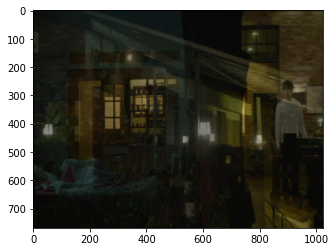

frame.__len__10, mAP_file:AnotherMissOh07_001_0035_IMAGE_0000002446.txt


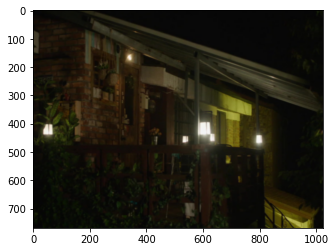

frame.__len__10, mAP_file:AnotherMissOh07_001_0035_IMAGE_0000002454.txt


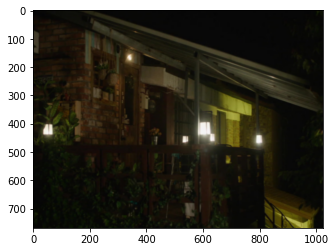

frame.__len__10, mAP_file:AnotherMissOh07_001_0035_IMAGE_0000002462.txt


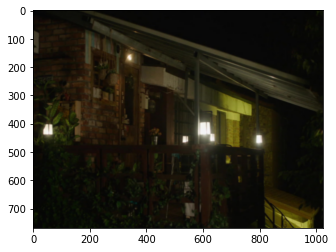

frame.__len__10, mAP_file:AnotherMissOh07_001_0035_IMAGE_0000002470.txt


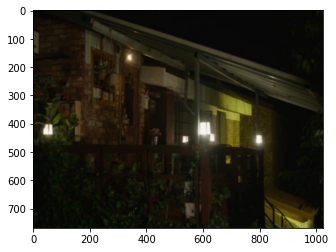

frame.__len__10, mAP_file:AnotherMissOh07_001_0035_IMAGE_0000002478.txt
frame.__len__10, mAP_file:AnotherMissOh07_001_0035_IMAGE_0000002486.txt
frame.__len__10, mAP_file:AnotherMissOh07_001_0035_IMAGE_0000002494.txt
frame.__len__10, mAP_file:AnotherMissOh07_001_0035_IMAGE_0000002502.txt
frame.__len__10, mAP_file:AnotherMissOh07_001_0035_IMAGE_0000002510.txt
frame.__len__10, mAP_file:AnotherMissOh07_002_0036_IMAGE_0000002632.txt


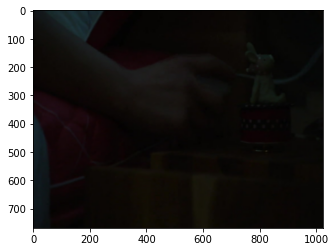

frame.__len__10, mAP_file:AnotherMissOh07_002_0036_IMAGE_0000002624.txt


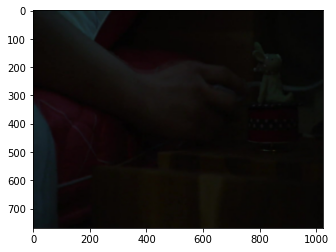

frame.__len__10, mAP_file:AnotherMissOh07_002_0036_IMAGE_0000002688.txt


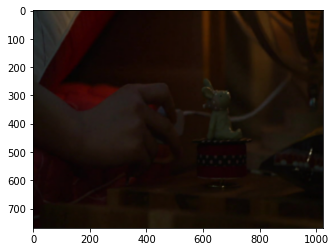

frame.__len__10, mAP_file:AnotherMissOh07_002_0036_IMAGE_0000002696.txt


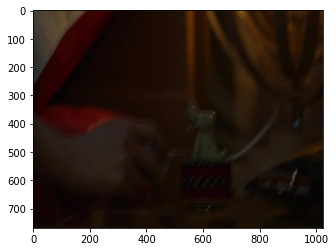

frame.__len__10, mAP_file:AnotherMissOh07_002_0036_IMAGE_0000002704.txt


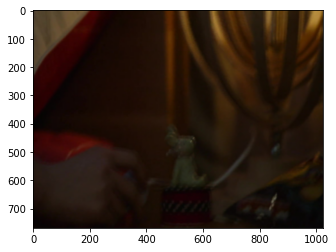

frame.__len__10, mAP_file:AnotherMissOh07_002_0036_IMAGE_0000002712.txt


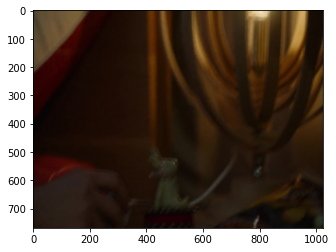

frame.__len__10, mAP_file:AnotherMissOh07_002_0036_IMAGE_0000002720.txt


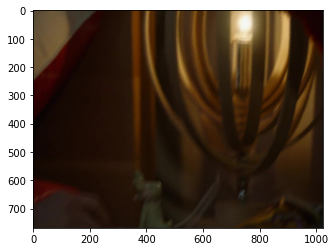

frame.__len__10, mAP_file:AnotherMissOh07_002_0036_IMAGE_0000002728.txt


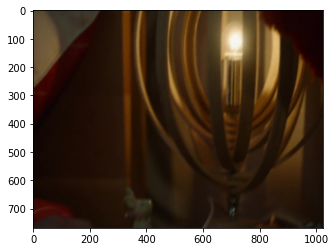

frame.__len__10, mAP_file:AnotherMissOh07_002_0036_IMAGE_0000002736.txt


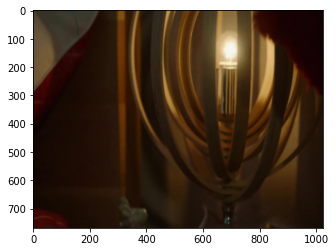

frame.__len__10, mAP_file:AnotherMissOh07_002_0036_IMAGE_0000002744.txt


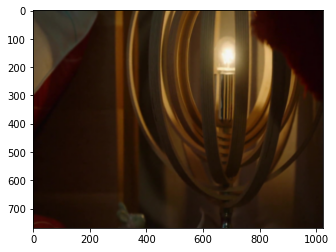

frame.__len__10, mAP_file:AnotherMissOh07_002_0037_IMAGE_0000002764.txt


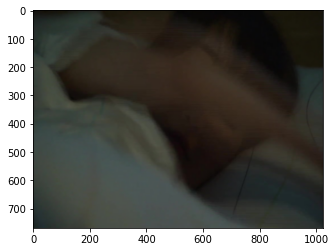

frame.__len__10, mAP_file:AnotherMissOh07_002_0037_IMAGE_0000002772.txt


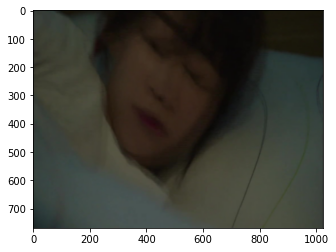

frame.__len__10, mAP_file:AnotherMissOh07_002_0037_IMAGE_0000002780.txt


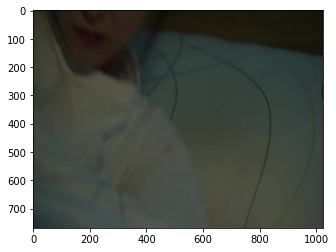

frame.__len__10, mAP_file:AnotherMissOh07_002_0037_IMAGE_0000002788.txt
frame.__len__10, mAP_file:AnotherMissOh07_002_0037_IMAGE_0000002796.txt
frame.__len__10, mAP_file:AnotherMissOh07_002_0037_IMAGE_0000002804.txt
frame.__len__10, mAP_file:AnotherMissOh07_002_0037_IMAGE_0000002812.txt
frame.__len__10, mAP_file:AnotherMissOh07_002_0037_IMAGE_0000002820.txt
frame.__len__10, mAP_file:AnotherMissOh07_002_0037_IMAGE_0000002828.txt
frame.__len__10, mAP_file:AnotherMissOh07_002_0037_IMAGE_0000002836.txt
frame.__len__10, mAP_file:AnotherMissOh07_002_0038_IMAGE_0000002930.txt


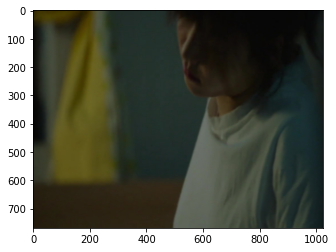

frame.__len__10, mAP_file:AnotherMissOh07_002_0038_IMAGE_0000002938.txt


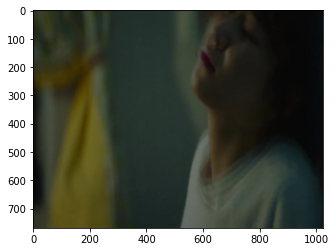

frame.__len__10, mAP_file:AnotherMissOh07_002_0038_IMAGE_0000002946.txt


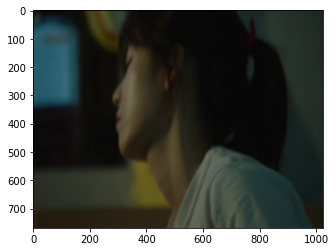

frame.__len__10, mAP_file:AnotherMissOh07_002_0038_IMAGE_0000002954.txt


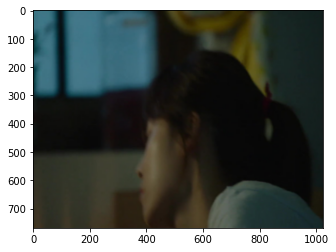

frame.__len__10, mAP_file:AnotherMissOh07_002_0038_IMAGE_0000002962.txt
frame.__len__10, mAP_file:AnotherMissOh07_002_0038_IMAGE_0000002970.txt
frame.__len__10, mAP_file:AnotherMissOh07_002_0038_IMAGE_0000002978.txt
frame.__len__10, mAP_file:AnotherMissOh07_002_0038_IMAGE_0000002986.txt
frame.__len__10, mAP_file:AnotherMissOh07_002_0038_IMAGE_0000002994.txt
frame.__len__10, mAP_file:AnotherMissOh07_002_0038_IMAGE_0000003002.txt
frame.__len__10, mAP_file:AnotherMissOh07_002_0039_IMAGE_0000003715.txt


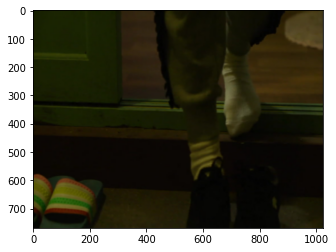

frame.__len__10, mAP_file:AnotherMissOh07_002_0039_IMAGE_0000003723.txt


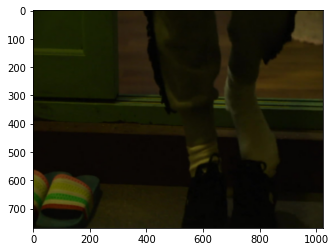

frame.__len__10, mAP_file:AnotherMissOh07_002_0039_IMAGE_0000003731.txt


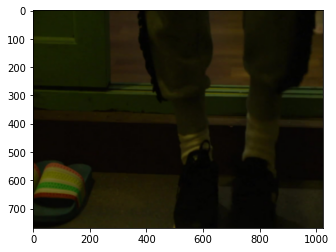

frame.__len__10, mAP_file:AnotherMissOh07_002_0039_IMAGE_0000003739.txt


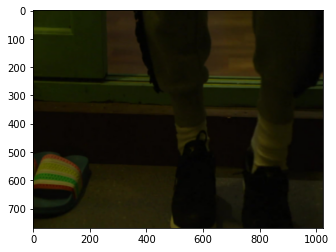

frame.__len__10, mAP_file:AnotherMissOh07_002_0039_IMAGE_0000003747.txt


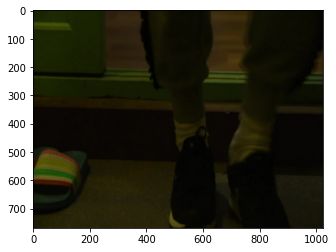

frame.__len__10, mAP_file:AnotherMissOh07_002_0039_IMAGE_0000003755.txt


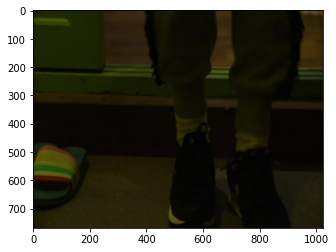

frame.__len__10, mAP_file:AnotherMissOh07_002_0039_IMAGE_0000003763.txt


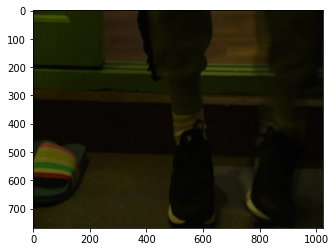

frame.__len__10, mAP_file:AnotherMissOh07_002_0039_IMAGE_0000003771.txt


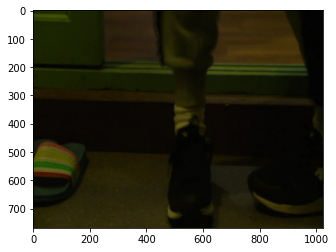

frame.__len__10, mAP_file:AnotherMissOh07_002_0039_IMAGE_0000003779.txt


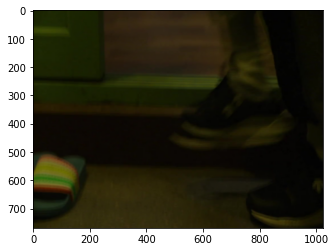

frame.__len__10, mAP_file:AnotherMissOh07_002_0039_IMAGE_0000003787.txt


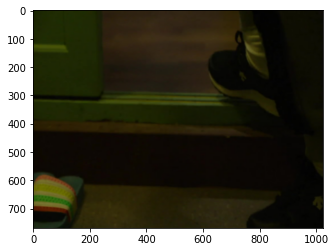

frame.__len__7, mAP_file:AnotherMissOh07_003_0043_IMAGE_0000004990.txt


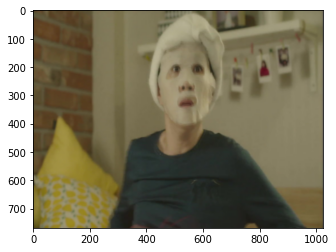

frame.__len__7, mAP_file:AnotherMissOh07_003_0043_IMAGE_0000004998.txt


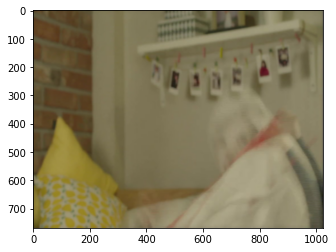

frame.__len__7, mAP_file:AnotherMissOh07_003_0043_IMAGE_0000005006.txt


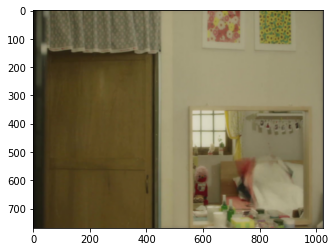

frame.__len__7, mAP_file:AnotherMissOh07_003_0043_IMAGE_0000005014.txt


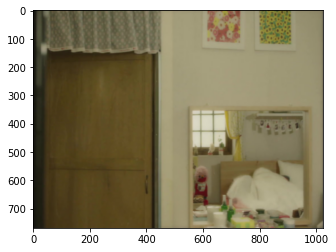

frame.__len__7, mAP_file:AnotherMissOh07_003_0043_IMAGE_0000005022.txt


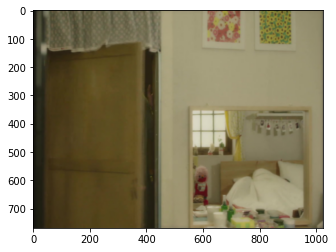

frame.__len__7, mAP_file:AnotherMissOh07_003_0043_IMAGE_0000005030.txt


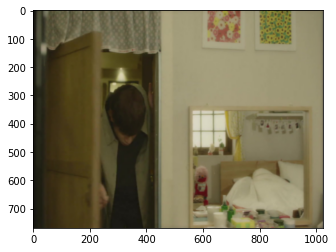

frame.__len__7, mAP_file:AnotherMissOh07_003_0043_IMAGE_0000005038.txt


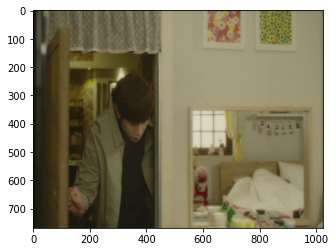

frame.__len__10, mAP_file:AnotherMissOh07_004_0045_IMAGE_0000005132.txt


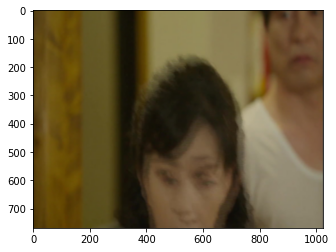

frame.__len__10, mAP_file:AnotherMissOh07_004_0045_IMAGE_0000005140.txt


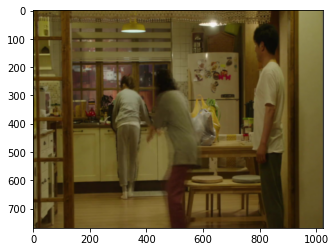

frame.__len__10, mAP_file:AnotherMissOh07_004_0045_IMAGE_0000005148.txt


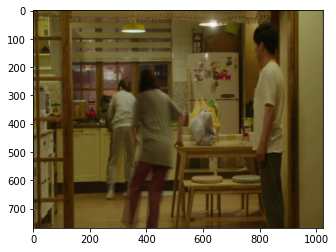

frame.__len__10, mAP_file:AnotherMissOh07_004_0045_IMAGE_0000005156.txt


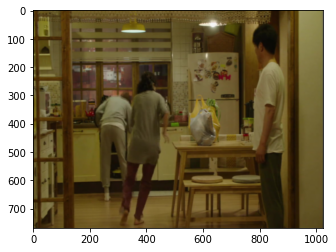

frame.__len__10, mAP_file:AnotherMissOh07_004_0045_IMAGE_0000005164.txt


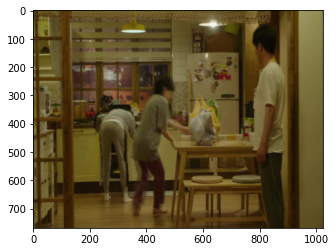

frame.__len__10, mAP_file:AnotherMissOh07_004_0045_IMAGE_0000005172.txt


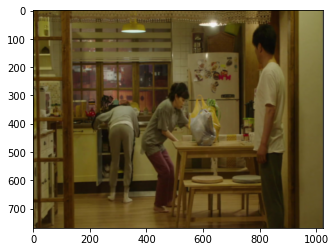

frame.__len__10, mAP_file:AnotherMissOh07_004_0045_IMAGE_0000005180.txt


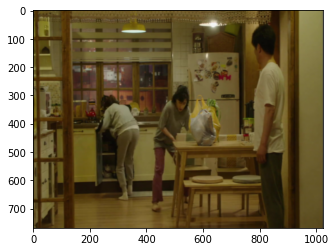

frame.__len__10, mAP_file:AnotherMissOh07_004_0045_IMAGE_0000005188.txt


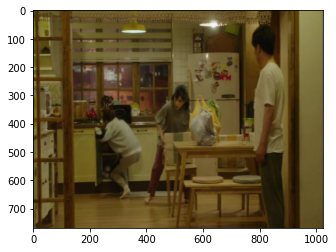

frame.__len__10, mAP_file:AnotherMissOh07_004_0045_IMAGE_0000005196.txt


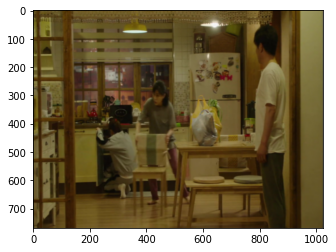

frame.__len__10, mAP_file:AnotherMissOh07_004_0045_IMAGE_0000005204.txt
frame.__len__6, mAP_file:AnotherMissOh07_004_0047_IMAGE_0000005251.txt


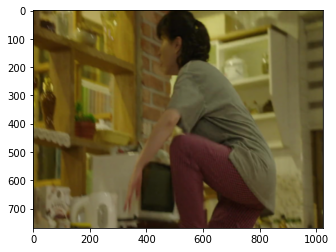

frame.__len__6, mAP_file:AnotherMissOh07_004_0047_IMAGE_0000005259.txt


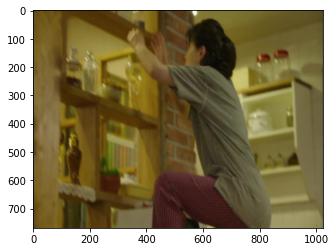

frame.__len__6, mAP_file:AnotherMissOh07_004_0047_IMAGE_0000005267.txt


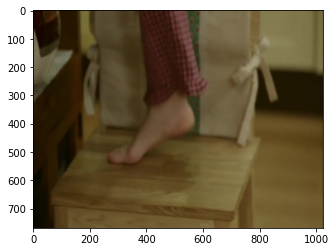

frame.__len__6, mAP_file:AnotherMissOh07_004_0047_IMAGE_0000005275.txt


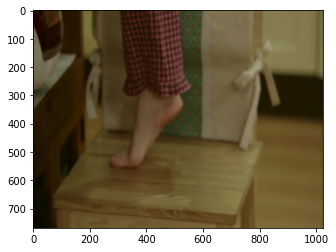

frame.__len__6, mAP_file:AnotherMissOh07_004_0047_IMAGE_0000005283.txt
frame.__len__6, mAP_file:AnotherMissOh07_004_0047_IMAGE_0000005291.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0048_IMAGE_0000005369.txt


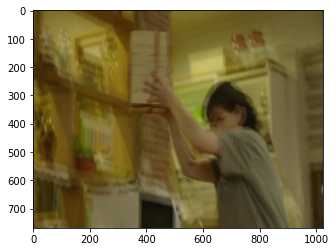

frame.__len__10, mAP_file:AnotherMissOh07_004_0048_IMAGE_0000005377.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0048_IMAGE_0000005385.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0048_IMAGE_0000005393.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0048_IMAGE_0000005401.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0048_IMAGE_0000005409.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0048_IMAGE_0000005417.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0048_IMAGE_0000005425.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0048_IMAGE_0000005433.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0048_IMAGE_0000005441.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0050_IMAGE_0000005576.txt


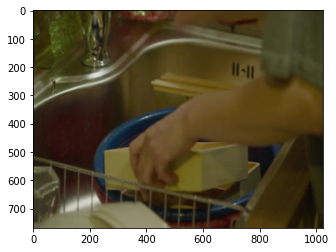

frame.__len__10, mAP_file:AnotherMissOh07_004_0050_IMAGE_0000005584.txt


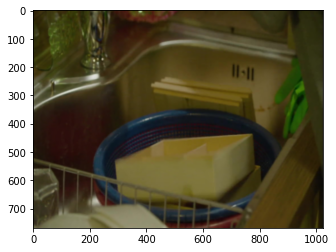

frame.__len__10, mAP_file:AnotherMissOh07_004_0050_IMAGE_0000005592.txt


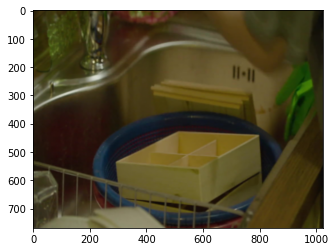

frame.__len__10, mAP_file:AnotherMissOh07_004_0050_IMAGE_0000005600.txt


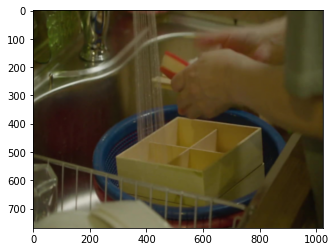

frame.__len__10, mAP_file:AnotherMissOh07_004_0050_IMAGE_0000005608.txt


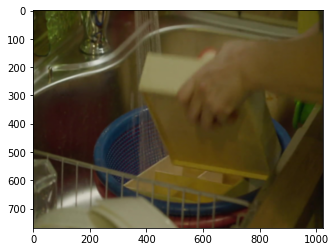

frame.__len__10, mAP_file:AnotherMissOh07_004_0050_IMAGE_0000005616.txt


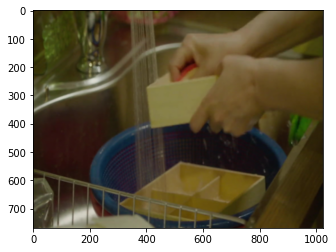

frame.__len__10, mAP_file:AnotherMissOh07_004_0050_IMAGE_0000005624.txt


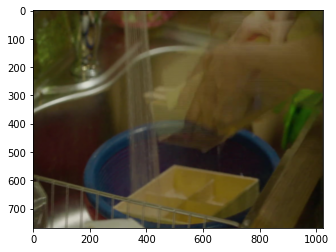

frame.__len__10, mAP_file:AnotherMissOh07_004_0050_IMAGE_0000005632.txt


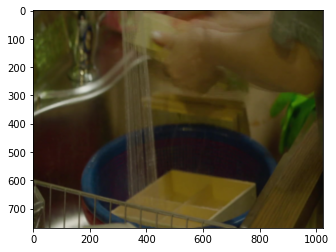

frame.__len__10, mAP_file:AnotherMissOh07_004_0050_IMAGE_0000005640.txt


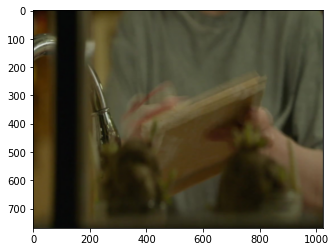

frame.__len__10, mAP_file:AnotherMissOh07_004_0050_IMAGE_0000005648.txt


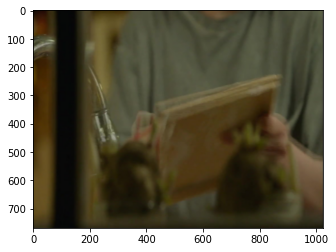

frame.__len__10, mAP_file:AnotherMissOh07_004_0051_IMAGE_0000005771.txt


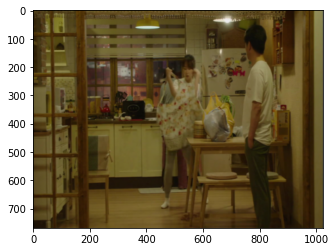

frame.__len__10, mAP_file:AnotherMissOh07_004_0051_IMAGE_0000005779.txt


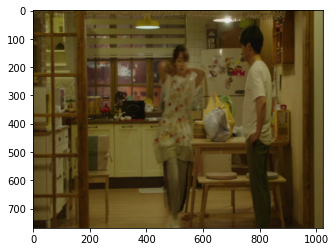

frame.__len__10, mAP_file:AnotherMissOh07_004_0051_IMAGE_0000005787.txt


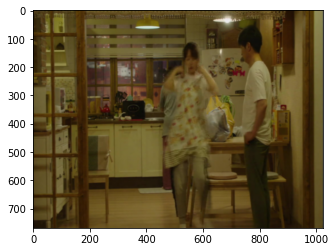

frame.__len__10, mAP_file:AnotherMissOh07_004_0051_IMAGE_0000005795.txt


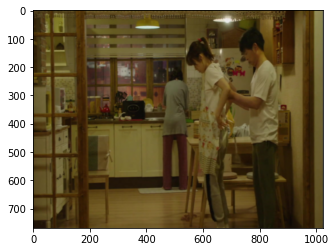

frame.__len__10, mAP_file:AnotherMissOh07_004_0051_IMAGE_0000005803.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0051_IMAGE_0000005811.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0051_IMAGE_0000005819.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0051_IMAGE_0000005827.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0051_IMAGE_0000005835.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0051_IMAGE_0000005843.txt
frame.__len__8, mAP_file:AnotherMissOh07_004_0052_IMAGE_0000005859.txt


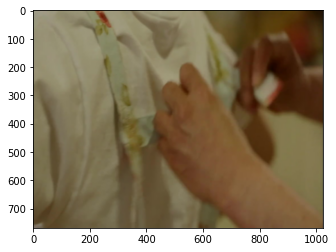

frame.__len__8, mAP_file:AnotherMissOh07_004_0052_IMAGE_0000005867.txt


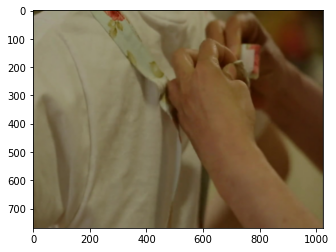

frame.__len__8, mAP_file:AnotherMissOh07_004_0052_IMAGE_0000005875.txt


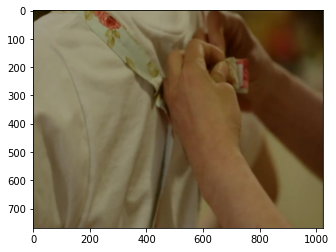

frame.__len__8, mAP_file:AnotherMissOh07_004_0052_IMAGE_0000005883.txt
frame.__len__8, mAP_file:AnotherMissOh07_004_0052_IMAGE_0000005891.txt
frame.__len__8, mAP_file:AnotherMissOh07_004_0052_IMAGE_0000005899.txt
frame.__len__8, mAP_file:AnotherMissOh07_004_0052_IMAGE_0000005907.txt
frame.__len__8, mAP_file:AnotherMissOh07_004_0052_IMAGE_0000005915.txt
frame.__len__3, mAP_file:AnotherMissOh07_004_0054_IMAGE_0000005985.txt


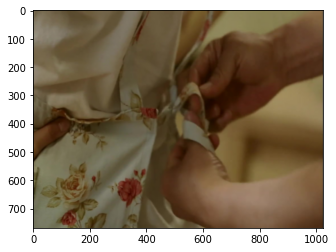

frame.__len__3, mAP_file:AnotherMissOh07_004_0054_IMAGE_0000005993.txt


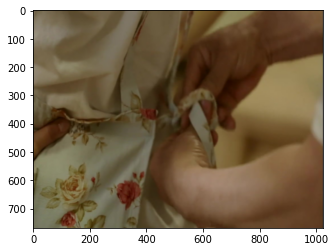

frame.__len__3, mAP_file:AnotherMissOh07_004_0054_IMAGE_0000006001.txt


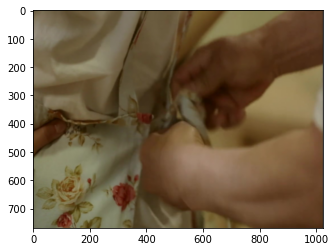

frame.__len__10, mAP_file:AnotherMissOh07_004_0055_IMAGE_0000006125.txt


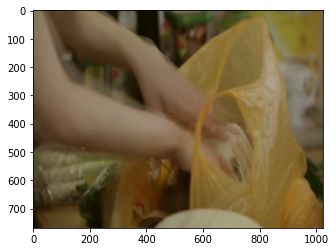

frame.__len__10, mAP_file:AnotherMissOh07_004_0055_IMAGE_0000006133.txt


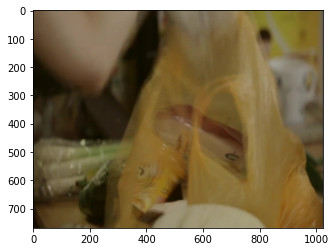

frame.__len__10, mAP_file:AnotherMissOh07_004_0055_IMAGE_0000006141.txt


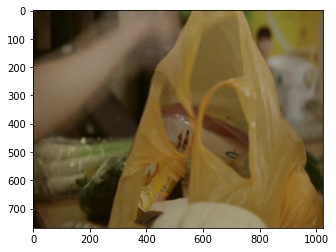

frame.__len__10, mAP_file:AnotherMissOh07_004_0055_IMAGE_0000006149.txt


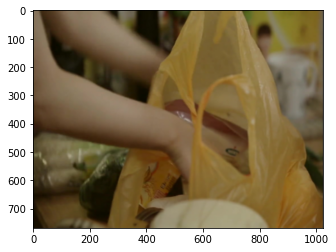

frame.__len__10, mAP_file:AnotherMissOh07_004_0055_IMAGE_0000006157.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0055_IMAGE_0000006165.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0055_IMAGE_0000006173.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0055_IMAGE_0000006181.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0055_IMAGE_0000006189.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0055_IMAGE_0000006197.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0056_IMAGE_0000006235.txt


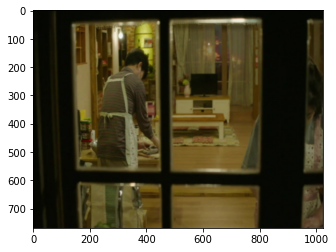

frame.__len__10, mAP_file:AnotherMissOh07_004_0056_IMAGE_0000006243.txt


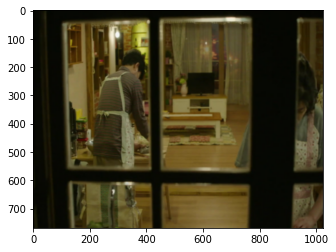

frame.__len__10, mAP_file:AnotherMissOh07_004_0056_IMAGE_0000006251.txt


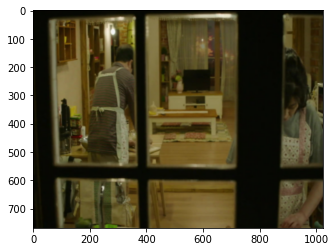

frame.__len__10, mAP_file:AnotherMissOh07_004_0056_IMAGE_0000006259.txt


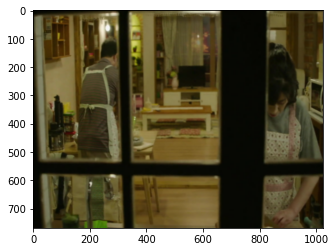

frame.__len__10, mAP_file:AnotherMissOh07_004_0056_IMAGE_0000006267.txt


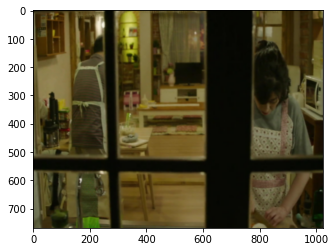

frame.__len__10, mAP_file:AnotherMissOh07_004_0056_IMAGE_0000006275.txt


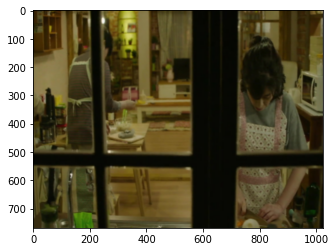

frame.__len__10, mAP_file:AnotherMissOh07_004_0056_IMAGE_0000006283.txt


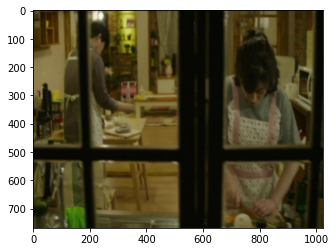

frame.__len__10, mAP_file:AnotherMissOh07_004_0056_IMAGE_0000006291.txt


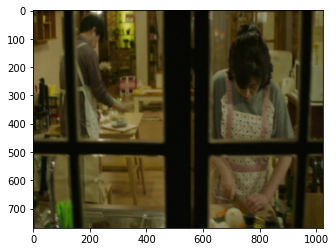

frame.__len__10, mAP_file:AnotherMissOh07_004_0056_IMAGE_0000006299.txt


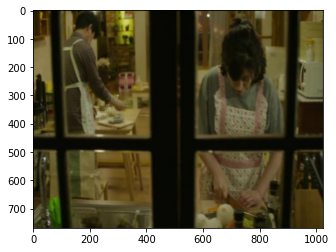

frame.__len__10, mAP_file:AnotherMissOh07_004_0056_IMAGE_0000006307.txt


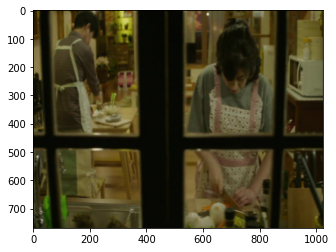

frame.__len__2, mAP_file:AnotherMissOh07_004_0057_IMAGE_0000006314.txt


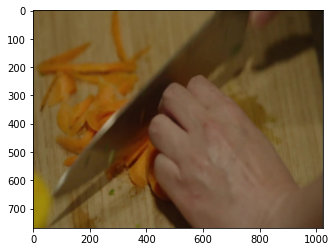

frame.__len__2, mAP_file:AnotherMissOh07_004_0057_IMAGE_0000006322.txt


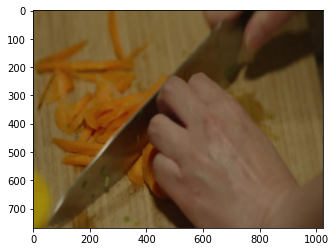

frame.__len__2, mAP_file:AnotherMissOh07_004_0058_IMAGE_0000006335.txt


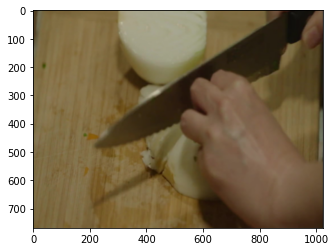

frame.__len__2, mAP_file:AnotherMissOh07_004_0058_IMAGE_0000006343.txt


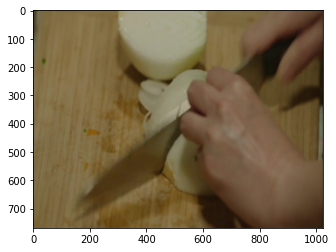

frame.__len__10, mAP_file:AnotherMissOh07_004_0059_IMAGE_0000006364.txt


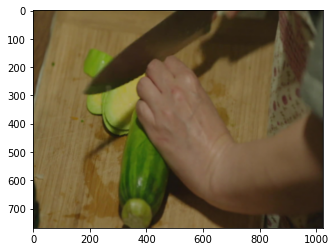

frame.__len__10, mAP_file:AnotherMissOh07_004_0059_IMAGE_0000006372.txt


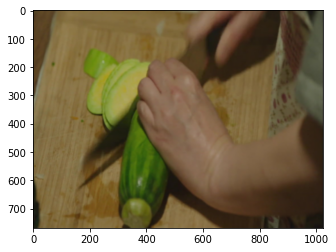

frame.__len__10, mAP_file:AnotherMissOh07_004_0059_IMAGE_0000006380.txt


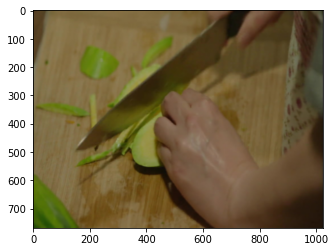

frame.__len__10, mAP_file:AnotherMissOh07_004_0059_IMAGE_0000006388.txt


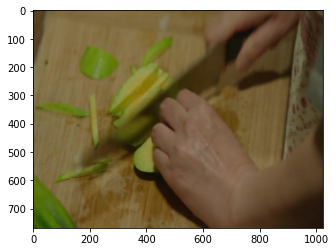

frame.__len__10, mAP_file:AnotherMissOh07_004_0059_IMAGE_0000006396.txt


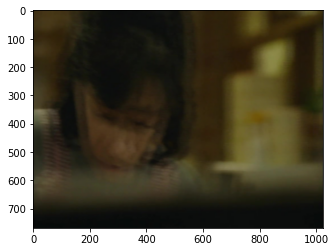

frame.__len__10, mAP_file:AnotherMissOh07_004_0059_IMAGE_0000006404.txt


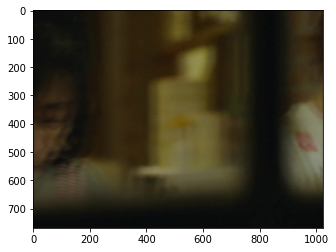

frame.__len__10, mAP_file:AnotherMissOh07_004_0059_IMAGE_0000006412.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0059_IMAGE_0000006420.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0059_IMAGE_0000006428.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0059_IMAGE_0000006436.txt
frame.__len__2, mAP_file:AnotherMissOh07_004_0060_IMAGE_0000006459.txt


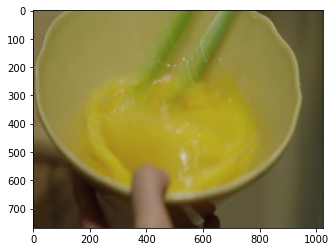

frame.__len__2, mAP_file:AnotherMissOh07_004_0060_IMAGE_0000006467.txt


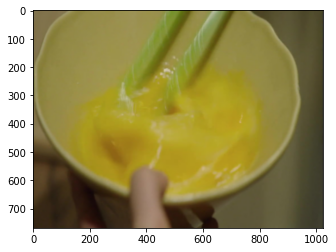

frame.__len__3, mAP_file:AnotherMissOh07_004_0061_IMAGE_0000006476.txt


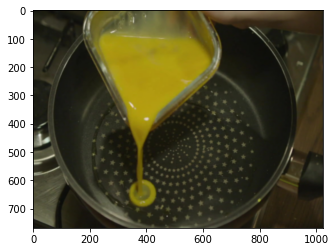

frame.__len__3, mAP_file:AnotherMissOh07_004_0061_IMAGE_0000006484.txt


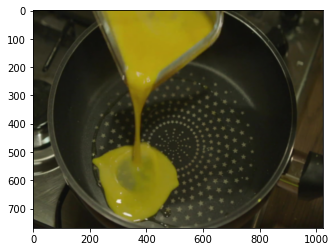

frame.__len__3, mAP_file:AnotherMissOh07_004_0061_IMAGE_0000006492.txt


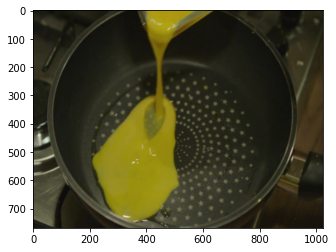

frame.__len__4, mAP_file:AnotherMissOh07_004_0062_IMAGE_0000006501.txt


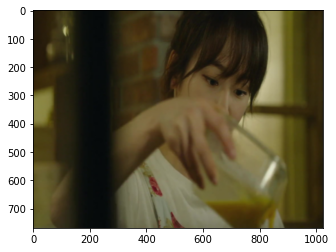

frame.__len__4, mAP_file:AnotherMissOh07_004_0062_IMAGE_0000006509.txt


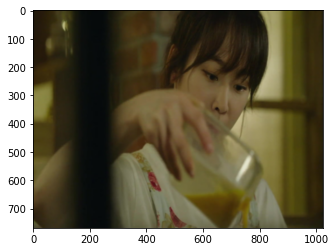

frame.__len__4, mAP_file:AnotherMissOh07_004_0062_IMAGE_0000006517.txt


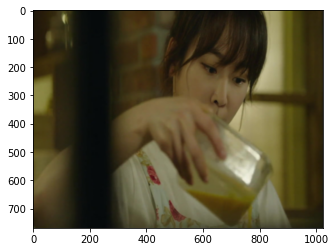

frame.__len__4, mAP_file:AnotherMissOh07_004_0062_IMAGE_0000006525.txt


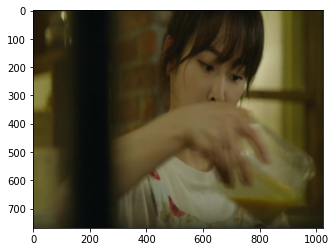

frame.__len__3, mAP_file:AnotherMissOh07_004_0063_IMAGE_0000006535.txt


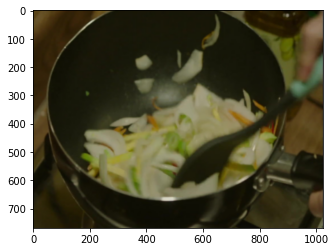

frame.__len__3, mAP_file:AnotherMissOh07_004_0063_IMAGE_0000006543.txt


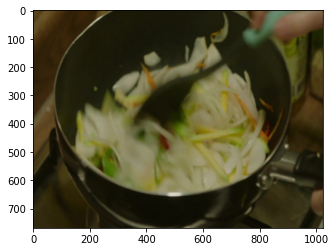

frame.__len__3, mAP_file:AnotherMissOh07_004_0063_IMAGE_0000006551.txt


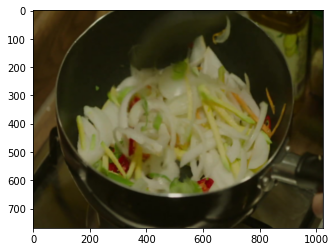

frame.__len__4, mAP_file:AnotherMissOh07_004_0064_IMAGE_0000006564.txt
person_pred:Haeyoung2 0.6572436690330505 271 0 720 768

detected ./results/drama-graph/AnotherMissOh07/004/0064/IMAGE_0000006564.jpg
non-detected ./results/drama-graph/AnotherMissOh07/004/0064/IMAGE_0000006564.jpg


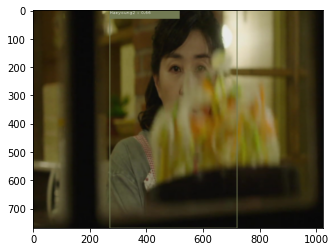

frame.__len__4, mAP_file:AnotherMissOh07_004_0064_IMAGE_0000006572.txt
frame.__len__4, mAP_file:AnotherMissOh07_004_0064_IMAGE_0000006580.txt
frame.__len__4, mAP_file:AnotherMissOh07_004_0064_IMAGE_0000006588.txt
frame.__len__3, mAP_file:AnotherMissOh07_004_0065_IMAGE_0000006600.txt


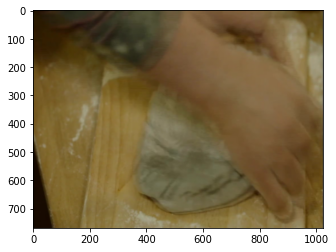

frame.__len__3, mAP_file:AnotherMissOh07_004_0065_IMAGE_0000006608.txt


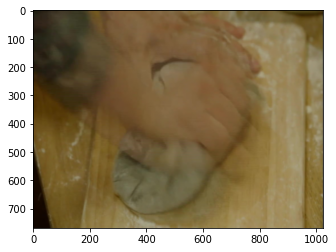

frame.__len__3, mAP_file:AnotherMissOh07_004_0065_IMAGE_0000006616.txt


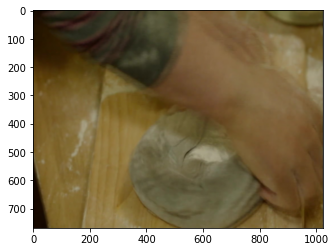

frame.__len__10, mAP_file:AnotherMissOh07_004_0066_IMAGE_0000006625.txt


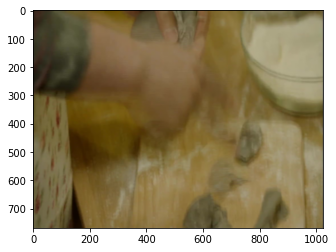

frame.__len__10, mAP_file:AnotherMissOh07_004_0066_IMAGE_0000006633.txt


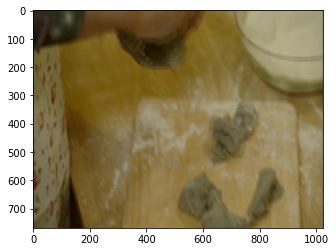

frame.__len__10, mAP_file:AnotherMissOh07_004_0066_IMAGE_0000006641.txt


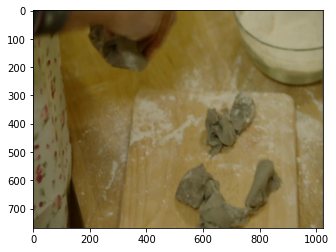

frame.__len__10, mAP_file:AnotherMissOh07_004_0066_IMAGE_0000006649.txt


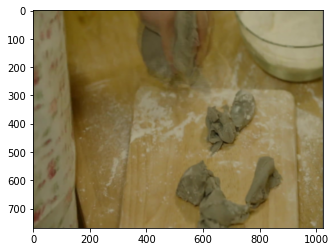

frame.__len__10, mAP_file:AnotherMissOh07_004_0066_IMAGE_0000006657.txt


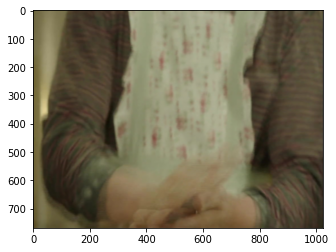

frame.__len__10, mAP_file:AnotherMissOh07_004_0066_IMAGE_0000006665.txt


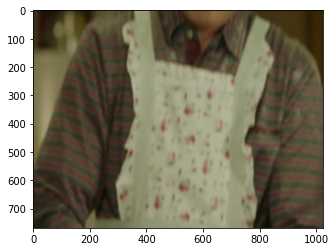

frame.__len__10, mAP_file:AnotherMissOh07_004_0066_IMAGE_0000006673.txt


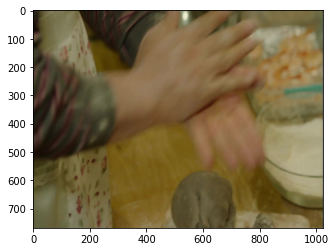

frame.__len__10, mAP_file:AnotherMissOh07_004_0066_IMAGE_0000006681.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0066_IMAGE_0000006689.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0066_IMAGE_0000006697.txt
frame.__len__9, mAP_file:AnotherMissOh07_004_0068_IMAGE_0000006769.txt


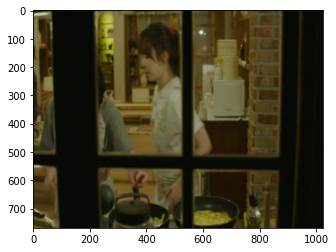

frame.__len__9, mAP_file:AnotherMissOh07_004_0068_IMAGE_0000006777.txt


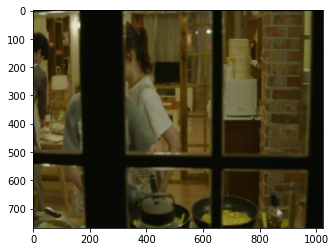

frame.__len__9, mAP_file:AnotherMissOh07_004_0068_IMAGE_0000006785.txt


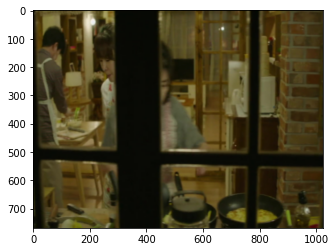

frame.__len__9, mAP_file:AnotherMissOh07_004_0068_IMAGE_0000006793.txt


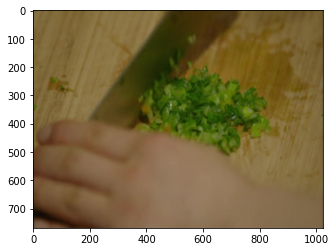

frame.__len__9, mAP_file:AnotherMissOh07_004_0068_IMAGE_0000006801.txt


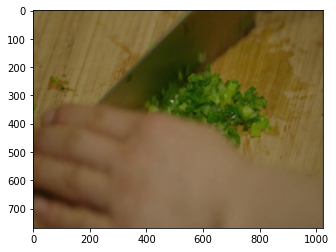

frame.__len__9, mAP_file:AnotherMissOh07_004_0068_IMAGE_0000006809.txt


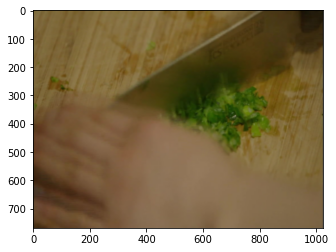

frame.__len__9, mAP_file:AnotherMissOh07_004_0068_IMAGE_0000006817.txt


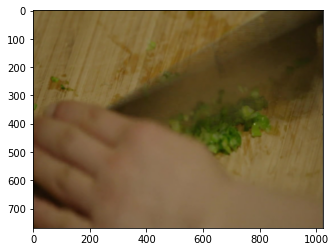

frame.__len__9, mAP_file:AnotherMissOh07_004_0068_IMAGE_0000006825.txt
frame.__len__9, mAP_file:AnotherMissOh07_004_0068_IMAGE_0000006833.txt
frame.__len__3, mAP_file:AnotherMissOh07_004_0070_IMAGE_0000006862.txt


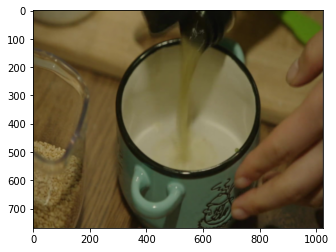

frame.__len__3, mAP_file:AnotherMissOh07_004_0070_IMAGE_0000006870.txt


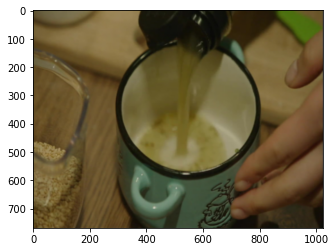

frame.__len__3, mAP_file:AnotherMissOh07_004_0070_IMAGE_0000006878.txt


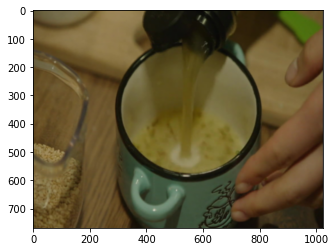

frame.__len__6, mAP_file:AnotherMissOh07_004_0071_IMAGE_0000006885.txt


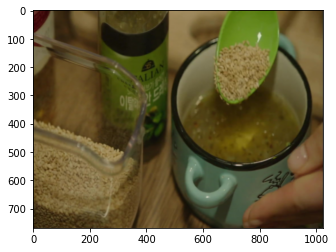

frame.__len__6, mAP_file:AnotherMissOh07_004_0071_IMAGE_0000006893.txt


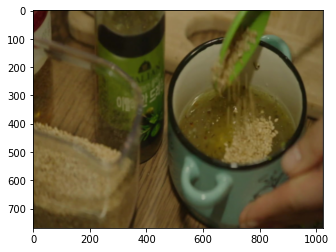

frame.__len__6, mAP_file:AnotherMissOh07_004_0071_IMAGE_0000006901.txt


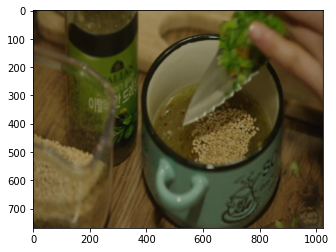

frame.__len__6, mAP_file:AnotherMissOh07_004_0071_IMAGE_0000006909.txt


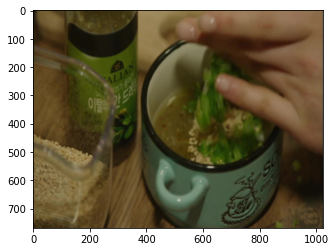

frame.__len__6, mAP_file:AnotherMissOh07_004_0071_IMAGE_0000006917.txt


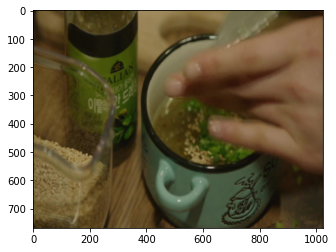

frame.__len__6, mAP_file:AnotherMissOh07_004_0071_IMAGE_0000006925.txt


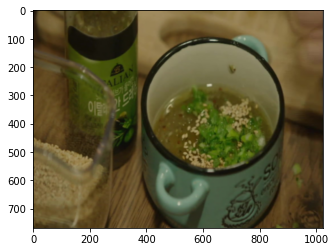

frame.__len__10, mAP_file:AnotherMissOh07_004_0072_IMAGE_0000006968.txt


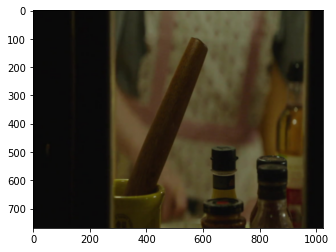

frame.__len__10, mAP_file:AnotherMissOh07_004_0072_IMAGE_0000006976.txt


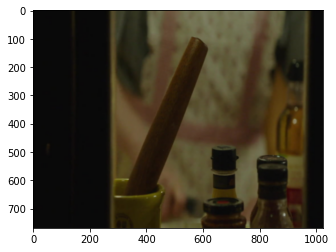

frame.__len__10, mAP_file:AnotherMissOh07_004_0072_IMAGE_0000006984.txt


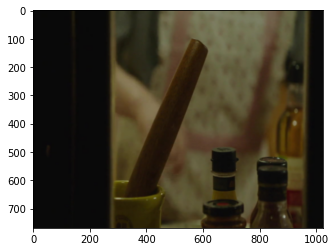

frame.__len__10, mAP_file:AnotherMissOh07_004_0072_IMAGE_0000006992.txt


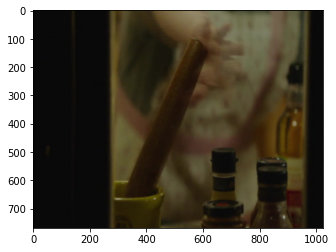

frame.__len__10, mAP_file:AnotherMissOh07_004_0072_IMAGE_0000007000.txt


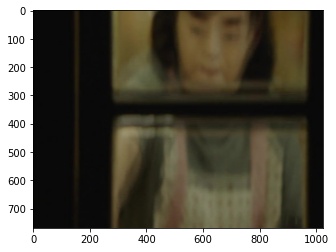

frame.__len__10, mAP_file:AnotherMissOh07_004_0072_IMAGE_0000007016.txt


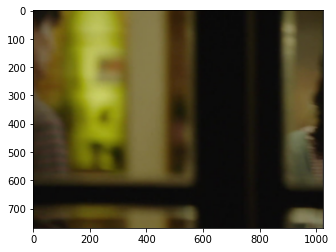

frame.__len__10, mAP_file:AnotherMissOh07_004_0072_IMAGE_0000007024.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0072_IMAGE_0000007032.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0072_IMAGE_0000007040.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0072_IMAGE_0000007048.txt
frame.__len__8, mAP_file:AnotherMissOh07_004_0073_IMAGE_0000007090.txt


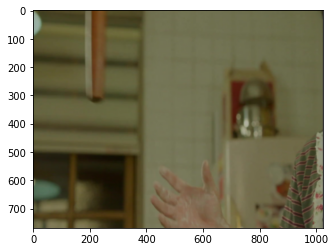

frame.__len__8, mAP_file:AnotherMissOh07_004_0073_IMAGE_0000007098.txt


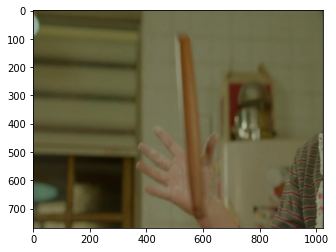

frame.__len__8, mAP_file:AnotherMissOh07_004_0073_IMAGE_0000007106.txt


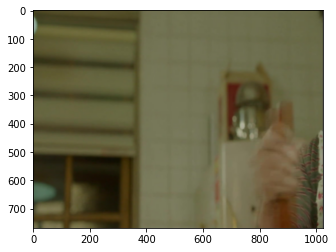

frame.__len__8, mAP_file:AnotherMissOh07_004_0073_IMAGE_0000007114.txt


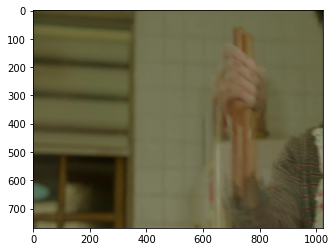

frame.__len__8, mAP_file:AnotherMissOh07_004_0073_IMAGE_0000007122.txt
frame.__len__8, mAP_file:AnotherMissOh07_004_0073_IMAGE_0000007130.txt
frame.__len__8, mAP_file:AnotherMissOh07_004_0073_IMAGE_0000007138.txt
frame.__len__8, mAP_file:AnotherMissOh07_004_0073_IMAGE_0000007146.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0075_IMAGE_0000007250.txt


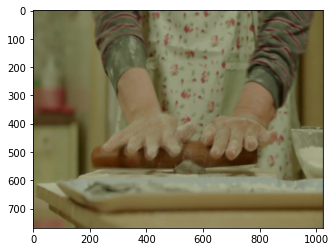

frame.__len__10, mAP_file:AnotherMissOh07_004_0075_IMAGE_0000007258.txt


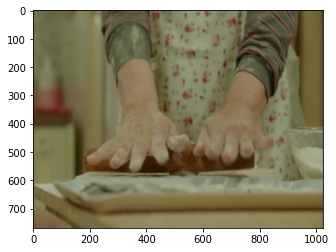

frame.__len__10, mAP_file:AnotherMissOh07_004_0075_IMAGE_0000007266.txt


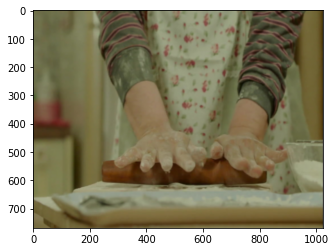

frame.__len__10, mAP_file:AnotherMissOh07_004_0075_IMAGE_0000007274.txt


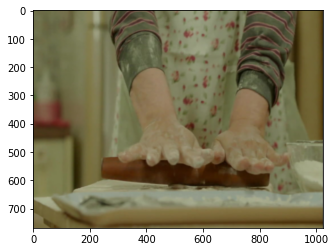

frame.__len__10, mAP_file:AnotherMissOh07_004_0075_IMAGE_0000007282.txt


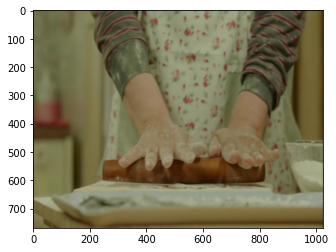

frame.__len__10, mAP_file:AnotherMissOh07_004_0075_IMAGE_0000007290.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0075_IMAGE_0000007298.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0075_IMAGE_0000007306.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0075_IMAGE_0000007314.txt
frame.__len__10, mAP_file:AnotherMissOh07_004_0075_IMAGE_0000007322.txt
frame.__len__5, mAP_file:AnotherMissOh07_004_0076_IMAGE_0000007340.txt


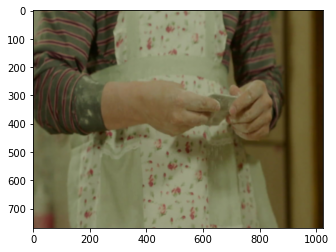

frame.__len__5, mAP_file:AnotherMissOh07_004_0076_IMAGE_0000007348.txt


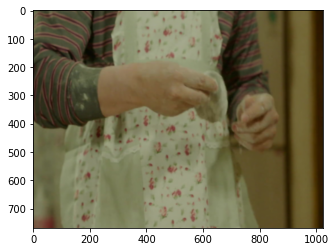

frame.__len__5, mAP_file:AnotherMissOh07_004_0076_IMAGE_0000007356.txt


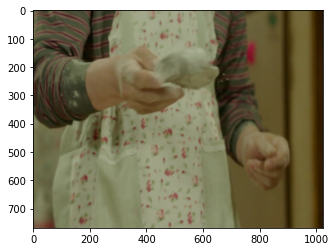

frame.__len__5, mAP_file:AnotherMissOh07_004_0076_IMAGE_0000007364.txt


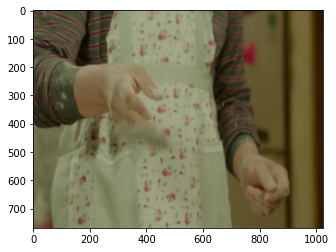

frame.__len__5, mAP_file:AnotherMissOh07_004_0076_IMAGE_0000007372.txt


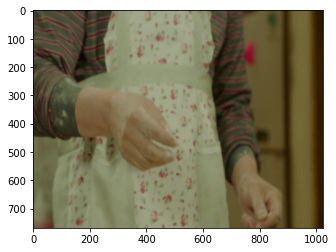

frame.__len__10, mAP_file:AnotherMissOh07_004_0077_IMAGE_0000007387.txt


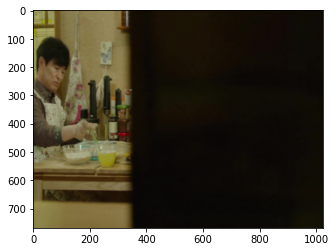

frame.__len__10, mAP_file:AnotherMissOh07_004_0077_IMAGE_0000007395.txt


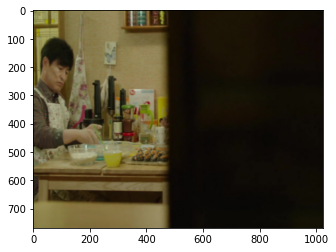

frame.__len__10, mAP_file:AnotherMissOh07_004_0077_IMAGE_0000007403.txt


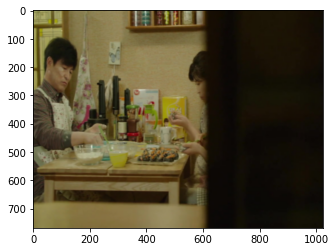

frame.__len__10, mAP_file:AnotherMissOh07_004_0077_IMAGE_0000007411.txt


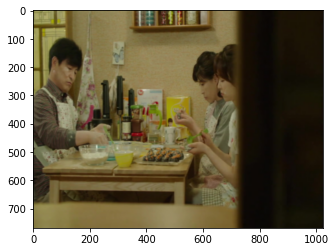

frame.__len__10, mAP_file:AnotherMissOh07_004_0077_IMAGE_0000007419.txt


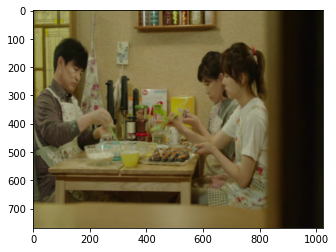

frame.__len__10, mAP_file:AnotherMissOh07_004_0077_IMAGE_0000007427.txt


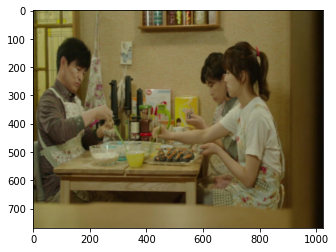

frame.__len__10, mAP_file:AnotherMissOh07_004_0077_IMAGE_0000007435.txt


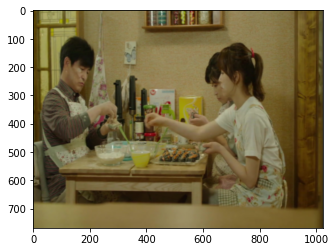

frame.__len__10, mAP_file:AnotherMissOh07_004_0077_IMAGE_0000007443.txt


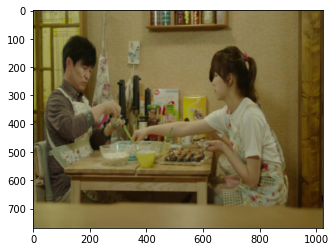

frame.__len__10, mAP_file:AnotherMissOh07_004_0077_IMAGE_0000007451.txt


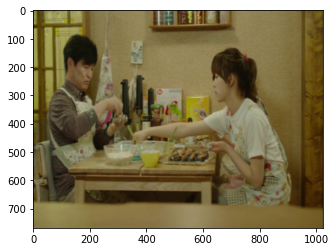

frame.__len__10, mAP_file:AnotherMissOh07_004_0077_IMAGE_0000007459.txt
frame.__len__8, mAP_file:AnotherMissOh07_004_0078_IMAGE_0000007486.txt


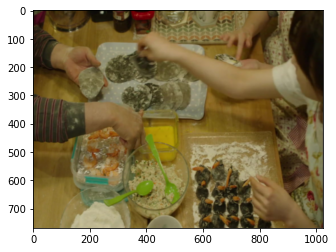

frame.__len__8, mAP_file:AnotherMissOh07_004_0078_IMAGE_0000007494.txt


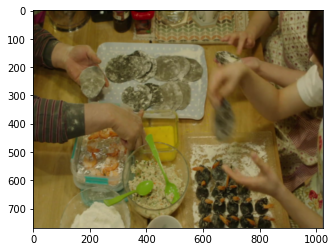

frame.__len__8, mAP_file:AnotherMissOh07_004_0078_IMAGE_0000007502.txt


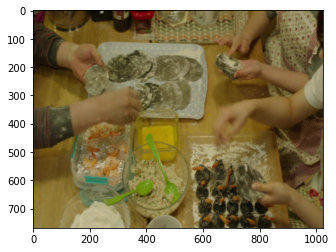

frame.__len__8, mAP_file:AnotherMissOh07_004_0078_IMAGE_0000007510.txt


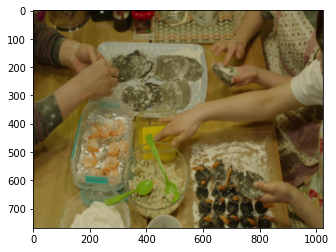

frame.__len__8, mAP_file:AnotherMissOh07_004_0078_IMAGE_0000007518.txt


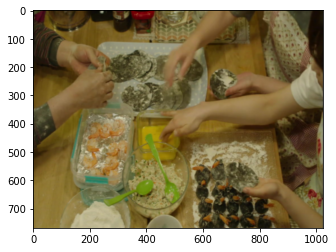

frame.__len__8, mAP_file:AnotherMissOh07_004_0078_IMAGE_0000007526.txt


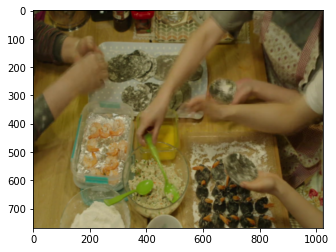

frame.__len__8, mAP_file:AnotherMissOh07_004_0078_IMAGE_0000007534.txt


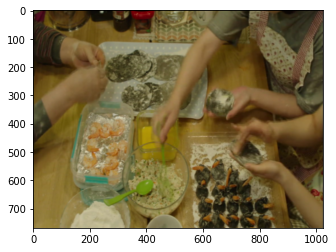

frame.__len__8, mAP_file:AnotherMissOh07_004_0078_IMAGE_0000007542.txt


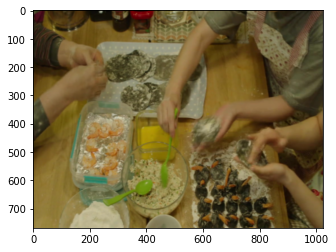

frame.__len__5, mAP_file:AnotherMissOh07_004_0079_IMAGE_0000007549.txt


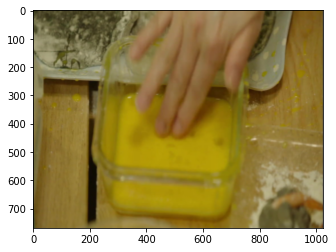

frame.__len__5, mAP_file:AnotherMissOh07_004_0079_IMAGE_0000007557.txt


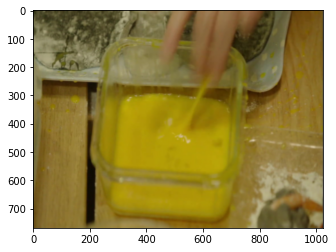

frame.__len__5, mAP_file:AnotherMissOh07_004_0079_IMAGE_0000007565.txt


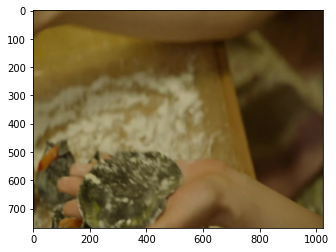

frame.__len__5, mAP_file:AnotherMissOh07_004_0079_IMAGE_0000007573.txt


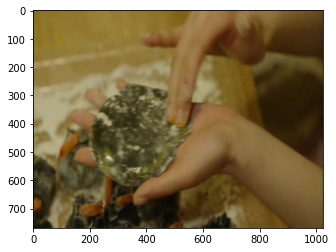

frame.__len__5, mAP_file:AnotherMissOh07_004_0079_IMAGE_0000007581.txt


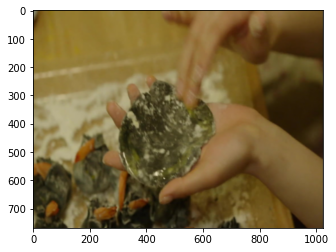

frame.__len__4, mAP_file:AnotherMissOh07_004_0080_IMAGE_0000007594.txt


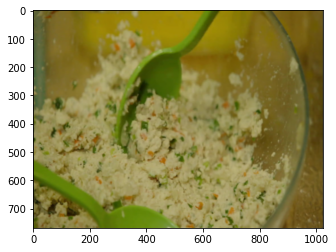

frame.__len__4, mAP_file:AnotherMissOh07_004_0080_IMAGE_0000007602.txt


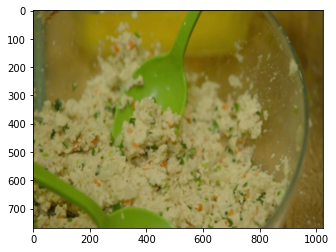

frame.__len__4, mAP_file:AnotherMissOh07_004_0080_IMAGE_0000007610.txt


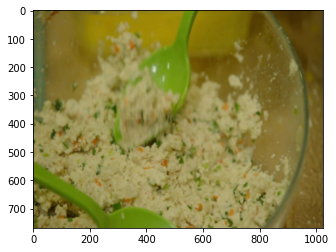

frame.__len__4, mAP_file:AnotherMissOh07_004_0080_IMAGE_0000007618.txt


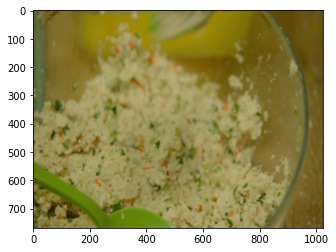

frame.__len__6, mAP_file:AnotherMissOh07_004_0081_IMAGE_0000007624.txt
person_pred:Haeyoung1 0.8844500780105591 516 46 1009 736

detected ./results/drama-graph/AnotherMissOh07/004/0081/IMAGE_0000007624.jpg
person_pred:Deogi 0.5187106132507324 55 15 513 768

detected ./results/drama-graph/AnotherMissOh07/004/0081/IMAGE_0000007624.jpg
non-detected ./results/drama-graph/AnotherMissOh07/004/0081/IMAGE_0000007624.jpg


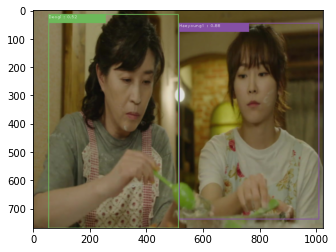

frame.__len__6, mAP_file:AnotherMissOh07_004_0081_IMAGE_0000007632.txt
person_pred:Haeyoung1 0.8540507555007935 518 2 1006 736

detected ./results/drama-graph/AnotherMissOh07/004/0081/IMAGE_0000007632.jpg
person_pred:Jinsang 0.810272753238678 29 18 561 725

detected ./results/drama-graph/AnotherMissOh07/004/0081/IMAGE_0000007632.jpg
non-detected ./results/drama-graph/AnotherMissOh07/004/0081/IMAGE_0000007632.jpg


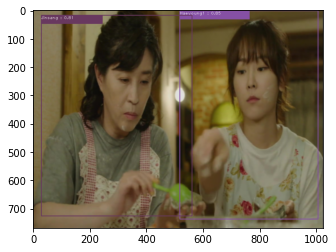

frame.__len__6, mAP_file:AnotherMissOh07_004_0081_IMAGE_0000007640.txt
person_pred:Haeyoung1 0.9208607077598572 433 18 977 743

detected ./results/drama-graph/AnotherMissOh07/004/0081/IMAGE_0000007640.jpg
person_pred:Deogi 0.7722590565681458 30 4 595 768

detected ./results/drama-graph/AnotherMissOh07/004/0081/IMAGE_0000007640.jpg
non-detected ./results/drama-graph/AnotherMissOh07/004/0081/IMAGE_0000007640.jpg


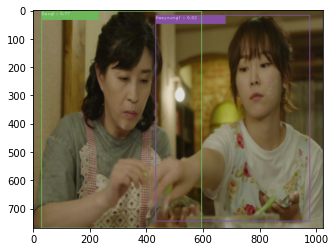

frame.__len__6, mAP_file:AnotherMissOh07_004_0081_IMAGE_0000007648.txt
person_pred:Jinsang 0.9130363464355469 18 14 578 746

detected ./results/drama-graph/AnotherMissOh07/004/0081/IMAGE_0000007648.jpg
person_pred:Haeyoung1 0.895050048828125 520 0 1006 749

detected ./results/drama-graph/AnotherMissOh07/004/0081/IMAGE_0000007648.jpg
non-detected ./results/drama-graph/AnotherMissOh07/004/0081/IMAGE_0000007648.jpg


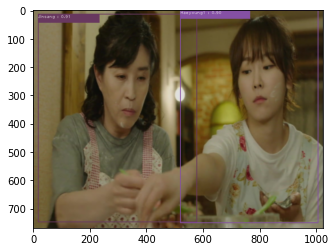

frame.__len__6, mAP_file:AnotherMissOh07_004_0081_IMAGE_0000007656.txt
person_pred:Haeyoung1 0.8951551914215088 526 0 992 756

detected ./results/drama-graph/AnotherMissOh07/004/0081/IMAGE_0000007656.jpg
person_pred:Deogi 0.5658314824104309 84 22 634 748

detected ./results/drama-graph/AnotherMissOh07/004/0081/IMAGE_0000007656.jpg
non-detected ./results/drama-graph/AnotherMissOh07/004/0081/IMAGE_0000007656.jpg


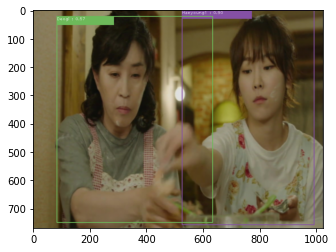

frame.__len__6, mAP_file:AnotherMissOh07_004_0081_IMAGE_0000007664.txt
person_pred:Haeyoung1 0.8710874319076538 516 30 1012 739

detected ./results/drama-graph/AnotherMissOh07/004/0081/IMAGE_0000007664.jpg
person_pred:Deogi 0.8108176589012146 33 6 553 764

detected ./results/drama-graph/AnotherMissOh07/004/0081/IMAGE_0000007664.jpg
non-detected ./results/drama-graph/AnotherMissOh07/004/0081/IMAGE_0000007664.jpg


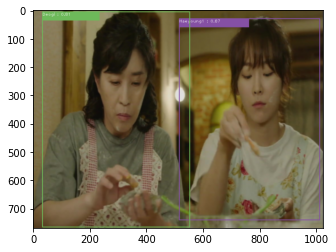

frame.__len__9, mAP_file:AnotherMissOh07_004_0082_IMAGE_0000007679.txt


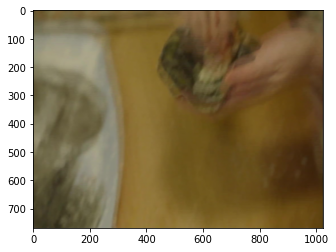

frame.__len__9, mAP_file:AnotherMissOh07_004_0082_IMAGE_0000007687.txt


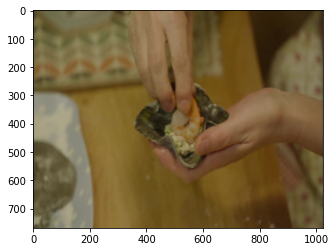

frame.__len__9, mAP_file:AnotherMissOh07_004_0082_IMAGE_0000007695.txt


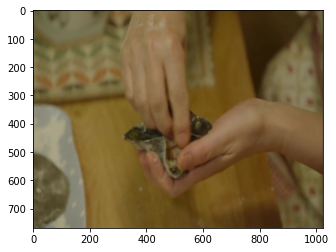

frame.__len__9, mAP_file:AnotherMissOh07_004_0082_IMAGE_0000007703.txt


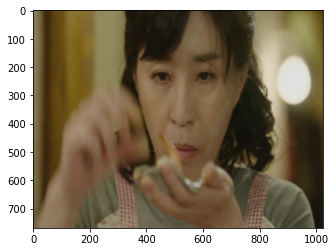

frame.__len__9, mAP_file:AnotherMissOh07_004_0082_IMAGE_0000007711.txt


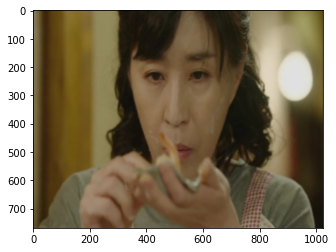

frame.__len__9, mAP_file:AnotherMissOh07_004_0082_IMAGE_0000007719.txt


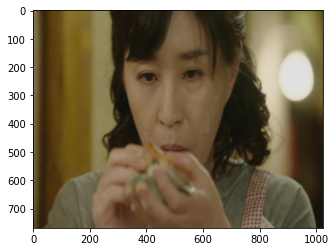

frame.__len__9, mAP_file:AnotherMissOh07_004_0082_IMAGE_0000007727.txt


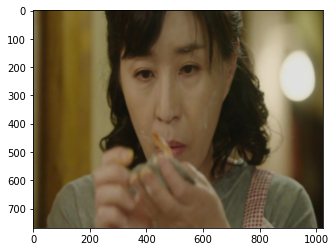

frame.__len__9, mAP_file:AnotherMissOh07_004_0082_IMAGE_0000007735.txt


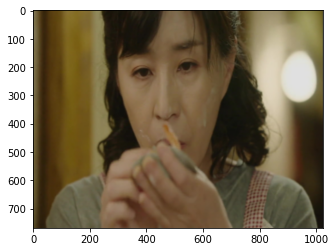

frame.__len__9, mAP_file:AnotherMissOh07_004_0082_IMAGE_0000007671.txt


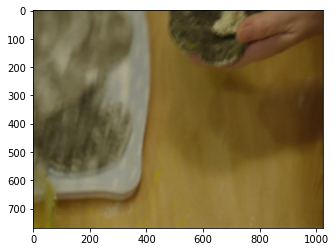

frame.__len__3, mAP_file:AnotherMissOh07_004_0083_IMAGE_0000007747.txt


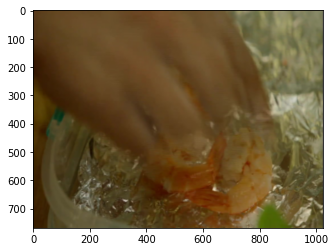

frame.__len__3, mAP_file:AnotherMissOh07_004_0083_IMAGE_0000007755.txt


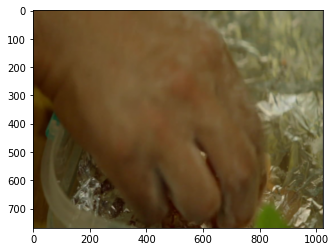

frame.__len__3, mAP_file:AnotherMissOh07_004_0083_IMAGE_0000007763.txt


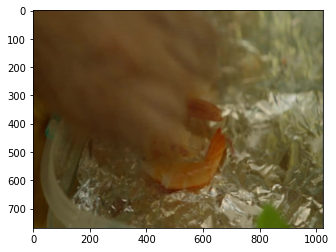

frame.__len__7, mAP_file:AnotherMissOh07_004_0084_IMAGE_0000007772.txt
person_pred:Jinsang 0.39903920888900757 118 17 742 718

detected ./results/drama-graph/AnotherMissOh07/004/0084/IMAGE_0000007772.jpg
non-detected ./results/drama-graph/AnotherMissOh07/004/0084/IMAGE_0000007772.jpg


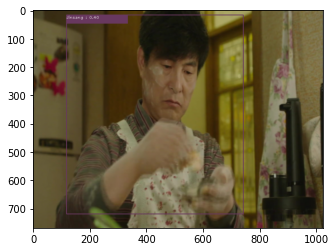

frame.__len__7, mAP_file:AnotherMissOh07_004_0084_IMAGE_0000007780.txt
person_pred:Dokyung 0.5111164450645447 128 13 710 737

detected ./results/drama-graph/AnotherMissOh07/004/0084/IMAGE_0000007780.jpg
non-detected ./results/drama-graph/AnotherMissOh07/004/0084/IMAGE_0000007780.jpg


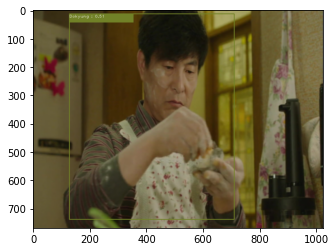

frame.__len__7, mAP_file:AnotherMissOh07_004_0084_IMAGE_0000007788.txt
person_pred:Dokyung 0.9370998740196228 160 15 675 733

detected ./results/drama-graph/AnotherMissOh07/004/0084/IMAGE_0000007788.jpg
non-detected ./results/drama-graph/AnotherMissOh07/004/0084/IMAGE_0000007788.jpg


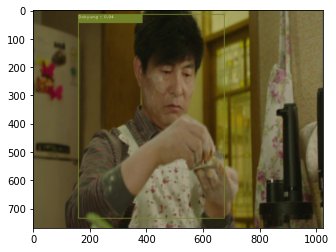

frame.__len__7, mAP_file:AnotherMissOh07_004_0084_IMAGE_0000007796.txt
person_pred:Dokyung 0.9546217322349548 122 8 708 757

detected ./results/drama-graph/AnotherMissOh07/004/0084/IMAGE_0000007796.jpg
non-detected ./results/drama-graph/AnotherMissOh07/004/0084/IMAGE_0000007796.jpg


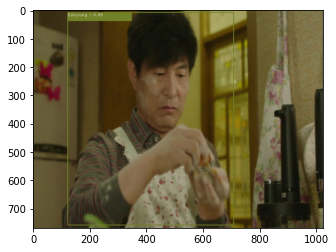

frame.__len__7, mAP_file:AnotherMissOh07_004_0084_IMAGE_0000007804.txt
person_pred:Dokyung 0.9407519698143005 89 0 748 768

detected ./results/drama-graph/AnotherMissOh07/004/0084/IMAGE_0000007804.jpg
non-detected ./results/drama-graph/AnotherMissOh07/004/0084/IMAGE_0000007804.jpg


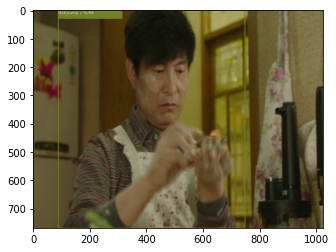

frame.__len__7, mAP_file:AnotherMissOh07_004_0084_IMAGE_0000007812.txt
person_pred:Dokyung 0.9511292576789856 101 5 770 744

detected ./results/drama-graph/AnotherMissOh07/004/0084/IMAGE_0000007812.jpg
non-detected ./results/drama-graph/AnotherMissOh07/004/0084/IMAGE_0000007812.jpg


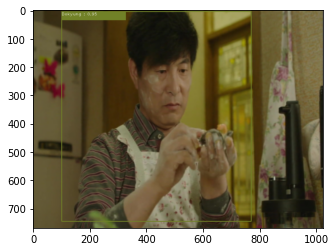

frame.__len__7, mAP_file:AnotherMissOh07_004_0084_IMAGE_0000007820.txt
person_pred:Dokyung 0.9337513446807861 95 0 781 755

detected ./results/drama-graph/AnotherMissOh07/004/0084/IMAGE_0000007820.jpg
non-detected ./results/drama-graph/AnotherMissOh07/004/0084/IMAGE_0000007820.jpg


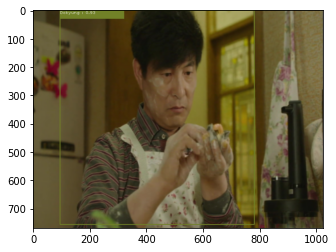

frame.__len__3, mAP_file:AnotherMissOh07_004_0085_IMAGE_0000007833.txt


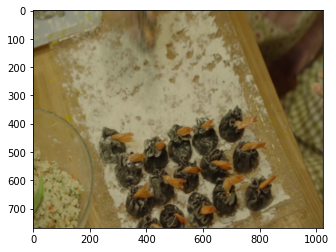

frame.__len__3, mAP_file:AnotherMissOh07_004_0085_IMAGE_0000007841.txt


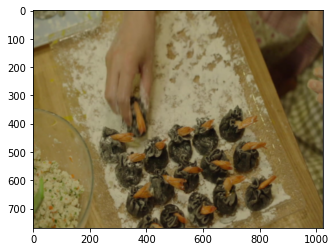

frame.__len__3, mAP_file:AnotherMissOh07_004_0085_IMAGE_0000007849.txt


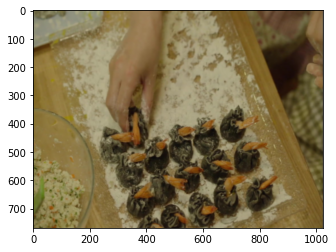

frame.__len__10, mAP_file:AnotherMissOh07_004_0086_IMAGE_0000007857.txt


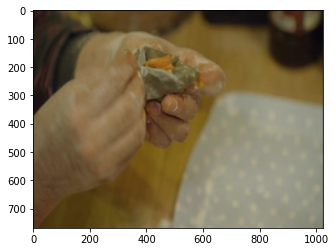

frame.__len__10, mAP_file:AnotherMissOh07_004_0086_IMAGE_0000007865.txt


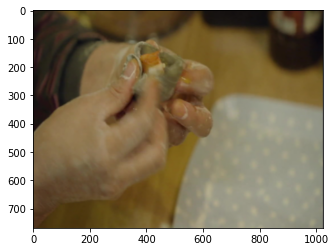

frame.__len__10, mAP_file:AnotherMissOh07_004_0086_IMAGE_0000007873.txt


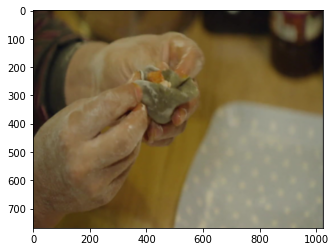

frame.__len__10, mAP_file:AnotherMissOh07_004_0086_IMAGE_0000007881.txt


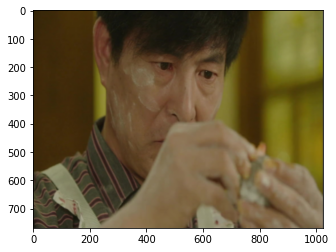

frame.__len__10, mAP_file:AnotherMissOh07_004_0086_IMAGE_0000007889.txt


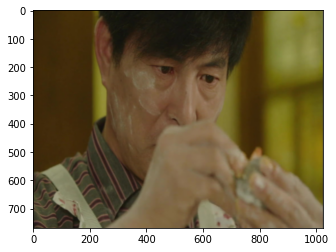

frame.__len__10, mAP_file:AnotherMissOh07_004_0086_IMAGE_0000007897.txt


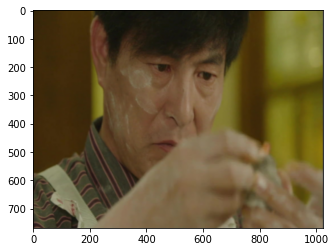

frame.__len__10, mAP_file:AnotherMissOh07_004_0086_IMAGE_0000007905.txt


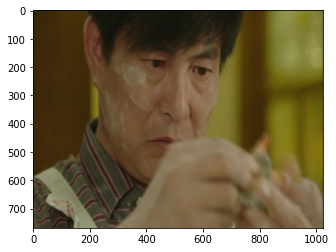

frame.__len__10, mAP_file:AnotherMissOh07_004_0086_IMAGE_0000007913.txt


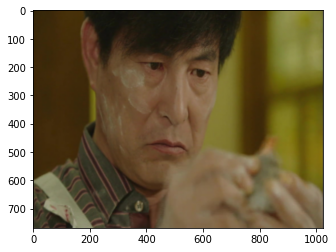

frame.__len__10, mAP_file:AnotherMissOh07_004_0086_IMAGE_0000007921.txt


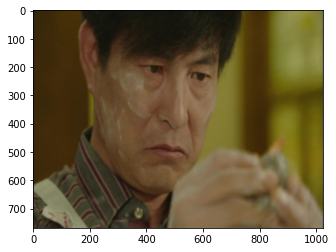

frame.__len__10, mAP_file:AnotherMissOh07_004_0086_IMAGE_0000007929.txt


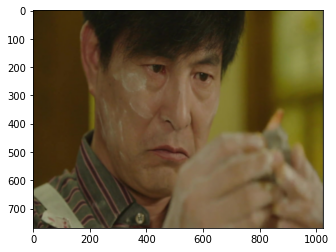

frame.__len__10, mAP_file:AnotherMissOh07_004_0087_IMAGE_0000007937.txt


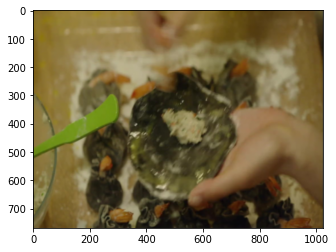

frame.__len__10, mAP_file:AnotherMissOh07_004_0087_IMAGE_0000007945.txt


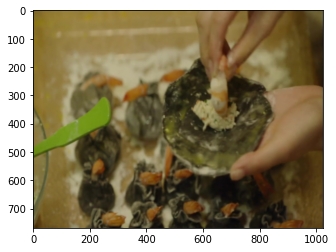

frame.__len__10, mAP_file:AnotherMissOh07_004_0087_IMAGE_0000007953.txt


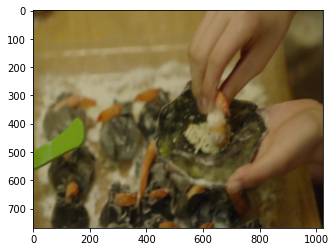

frame.__len__10, mAP_file:AnotherMissOh07_004_0087_IMAGE_0000007961.txt


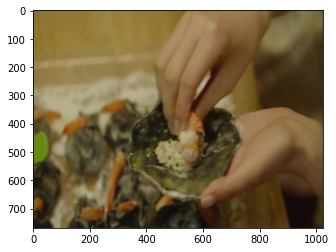

frame.__len__10, mAP_file:AnotherMissOh07_004_0087_IMAGE_0000007969.txt


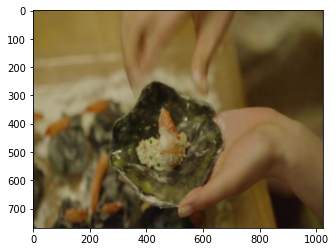

frame.__len__10, mAP_file:AnotherMissOh07_004_0087_IMAGE_0000007977.txt


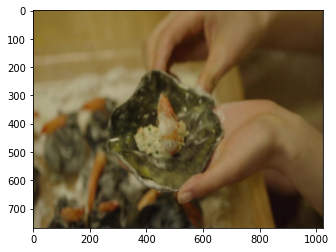

frame.__len__10, mAP_file:AnotherMissOh07_004_0087_IMAGE_0000007985.txt


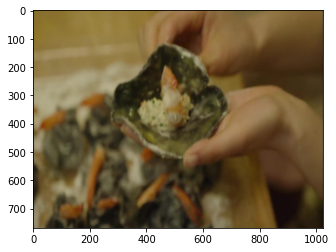

frame.__len__10, mAP_file:AnotherMissOh07_004_0087_IMAGE_0000007993.txt


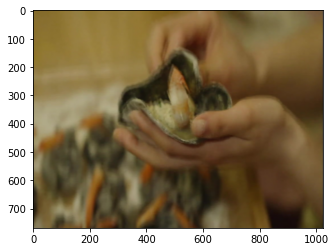

frame.__len__10, mAP_file:AnotherMissOh07_004_0087_IMAGE_0000008001.txt


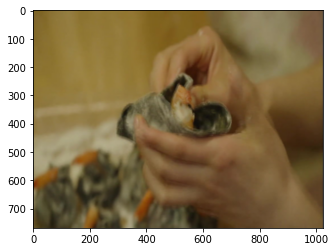

frame.__len__10, mAP_file:AnotherMissOh07_004_0087_IMAGE_0000008009.txt
frame.__len__4, mAP_file:AnotherMissOh07_004_0088_IMAGE_0000008045.txt


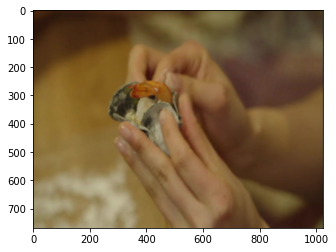

frame.__len__4, mAP_file:AnotherMissOh07_004_0088_IMAGE_0000008053.txt


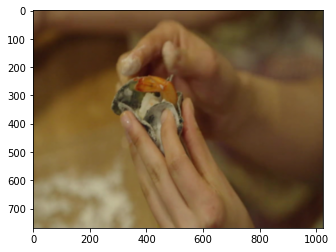

frame.__len__4, mAP_file:AnotherMissOh07_004_0088_IMAGE_0000008061.txt


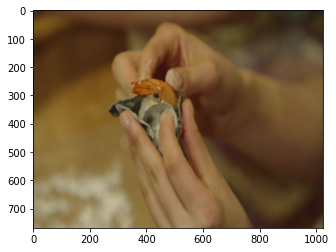

frame.__len__4, mAP_file:AnotherMissOh07_004_0088_IMAGE_0000008069.txt


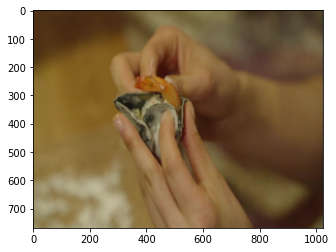

frame.__len__7, mAP_file:AnotherMissOh07_004_0089_IMAGE_0000008079.txt
person_pred:Haeyoung1 0.9722587466239929 203 3 982 765

detected ./results/drama-graph/AnotherMissOh07/004/0089/IMAGE_0000008079.jpg
non-detected ./results/drama-graph/AnotherMissOh07/004/0089/IMAGE_0000008079.jpg


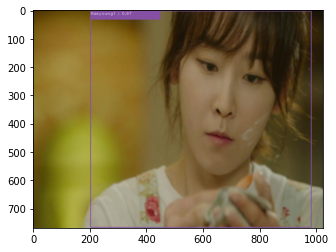

frame.__len__7, mAP_file:AnotherMissOh07_004_0089_IMAGE_0000008087.txt
person_pred:Haeyoung1 0.9686657190322876 204 0 982 768

detected ./results/drama-graph/AnotherMissOh07/004/0089/IMAGE_0000008087.jpg
non-detected ./results/drama-graph/AnotherMissOh07/004/0089/IMAGE_0000008087.jpg


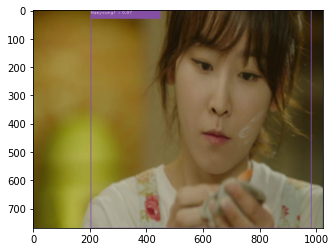

frame.__len__7, mAP_file:AnotherMissOh07_004_0089_IMAGE_0000008095.txt
person_pred:Haeyoung1 0.9667662382125854 180 2 1024 759

detected ./results/drama-graph/AnotherMissOh07/004/0089/IMAGE_0000008095.jpg
non-detected ./results/drama-graph/AnotherMissOh07/004/0089/IMAGE_0000008095.jpg


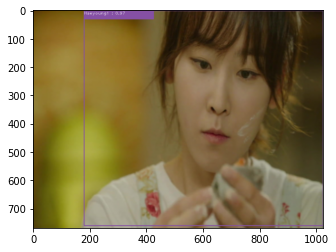

frame.__len__7, mAP_file:AnotherMissOh07_004_0089_IMAGE_0000008103.txt
person_pred:Haeyoung1 0.9356580376625061 199 3 1004 754

detected ./results/drama-graph/AnotherMissOh07/004/0089/IMAGE_0000008103.jpg
non-detected ./results/drama-graph/AnotherMissOh07/004/0089/IMAGE_0000008103.jpg


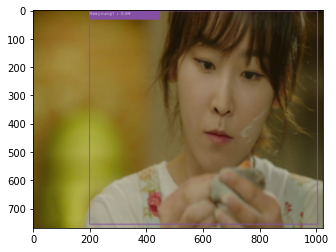

frame.__len__7, mAP_file:AnotherMissOh07_004_0089_IMAGE_0000008111.txt
person_pred:Haeyoung1 0.9566295742988586 195 0 1013 760

detected ./results/drama-graph/AnotherMissOh07/004/0089/IMAGE_0000008111.jpg
non-detected ./results/drama-graph/AnotherMissOh07/004/0089/IMAGE_0000008111.jpg


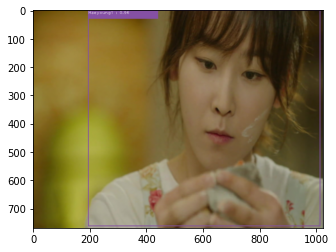

frame.__len__7, mAP_file:AnotherMissOh07_004_0089_IMAGE_0000008119.txt
person_pred:Haeyoung1 0.9771191477775574 190 2 1002 764

detected ./results/drama-graph/AnotherMissOh07/004/0089/IMAGE_0000008119.jpg
non-detected ./results/drama-graph/AnotherMissOh07/004/0089/IMAGE_0000008119.jpg


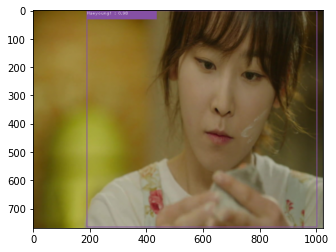

frame.__len__7, mAP_file:AnotherMissOh07_004_0089_IMAGE_0000008127.txt
person_pred:Haeyoung1 0.9223233461380005 209 10 991 737

detected ./results/drama-graph/AnotherMissOh07/004/0089/IMAGE_0000008127.jpg
non-detected ./results/drama-graph/AnotherMissOh07/004/0089/IMAGE_0000008127.jpg


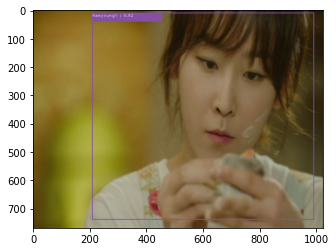

frame.__len__10, mAP_file:AnotherMissOh07_004_0090_IMAGE_0000008188.txt


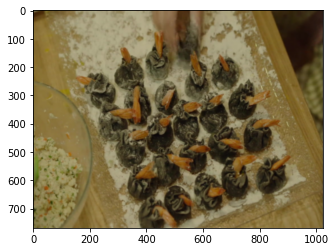

frame.__len__10, mAP_file:AnotherMissOh07_004_0090_IMAGE_0000008196.txt


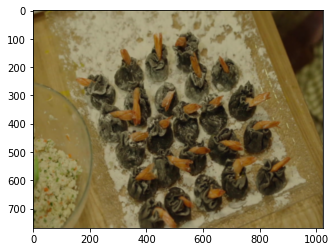

frame.__len__10, mAP_file:AnotherMissOh07_004_0090_IMAGE_0000008204.txt


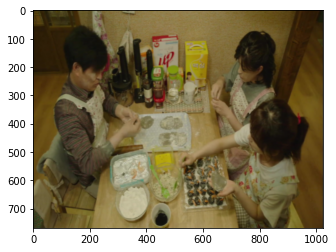

frame.__len__10, mAP_file:AnotherMissOh07_004_0090_IMAGE_0000008212.txt


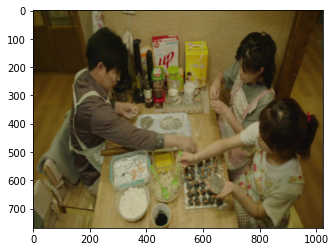

frame.__len__10, mAP_file:AnotherMissOh07_004_0090_IMAGE_0000008220.txt


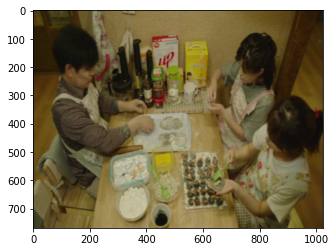

frame.__len__10, mAP_file:AnotherMissOh07_004_0090_IMAGE_0000008228.txt


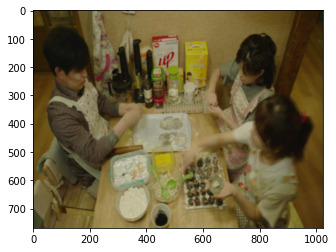

frame.__len__10, mAP_file:AnotherMissOh07_004_0090_IMAGE_0000008236.txt


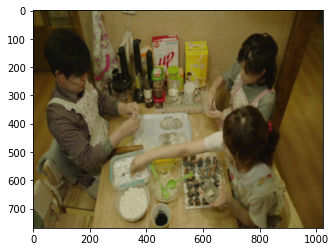

frame.__len__10, mAP_file:AnotherMissOh07_004_0090_IMAGE_0000008244.txt


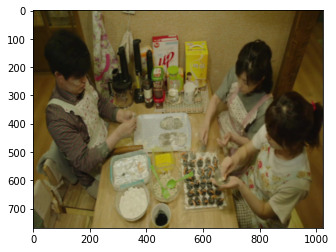

frame.__len__10, mAP_file:AnotherMissOh07_004_0090_IMAGE_0000008252.txt


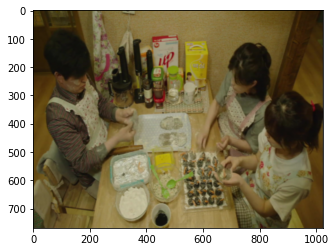

frame.__len__10, mAP_file:AnotherMissOh07_004_0090_IMAGE_0000008260.txt


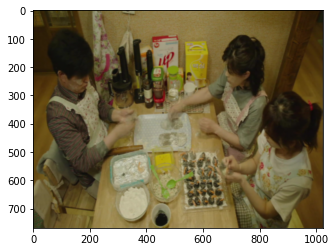

frame.__len__7, mAP_file:AnotherMissOh07_005_0091_IMAGE_0000008308.txt
person_pred:Haeyoung1 0.7554364204406738 415 119 698 710

detected ./results/drama-graph/AnotherMissOh07/005/0091/IMAGE_0000008308.jpg
non-detected ./results/drama-graph/AnotherMissOh07/005/0091/IMAGE_0000008308.jpg


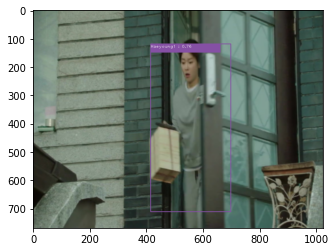

frame.__len__7, mAP_file:AnotherMissOh07_005_0091_IMAGE_0000008316.txt
person_pred:Haeyoung1 0.9114272594451904 400 2 781 751

detected ./results/drama-graph/AnotherMissOh07/005/0091/IMAGE_0000008316.jpg
non-detected ./results/drama-graph/AnotherMissOh07/005/0091/IMAGE_0000008316.jpg


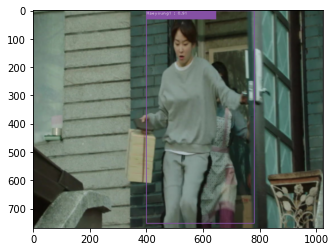

frame.__len__7, mAP_file:AnotherMissOh07_005_0091_IMAGE_0000008324.txt
person_pred:Jinsang 0.3579474091529846 536 86 974 738

detected ./results/drama-graph/AnotherMissOh07/005/0091/IMAGE_0000008324.jpg
non-detected ./results/drama-graph/AnotherMissOh07/005/0091/IMAGE_0000008324.jpg


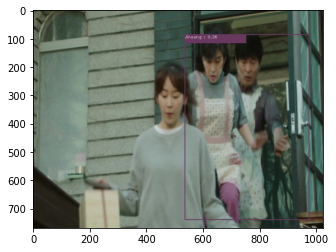

frame.__len__7, mAP_file:AnotherMissOh07_005_0091_IMAGE_0000008332.txt
person_pred:Haeyoung1 0.361684650182724 496 15 874 693

detected ./results/drama-graph/AnotherMissOh07/005/0091/IMAGE_0000008332.jpg
non-detected ./results/drama-graph/AnotherMissOh07/005/0091/IMAGE_0000008332.jpg


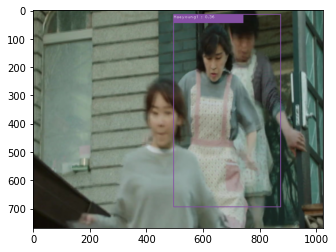

frame.__len__7, mAP_file:AnotherMissOh07_005_0091_IMAGE_0000008340.txt
frame.__len__7, mAP_file:AnotherMissOh07_005_0091_IMAGE_0000008348.txt
frame.__len__7, mAP_file:AnotherMissOh07_005_0091_IMAGE_0000008356.txt
frame.__len__10, mAP_file:AnotherMissOh07_005_0092_IMAGE_0000008394.txt


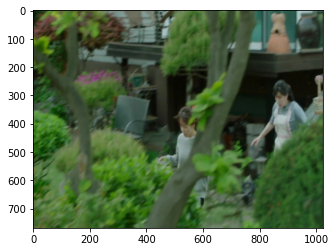

frame.__len__10, mAP_file:AnotherMissOh07_005_0092_IMAGE_0000008402.txt


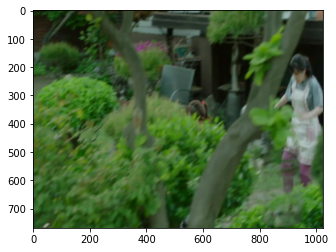

frame.__len__10, mAP_file:AnotherMissOh07_005_0092_IMAGE_0000008442.txt


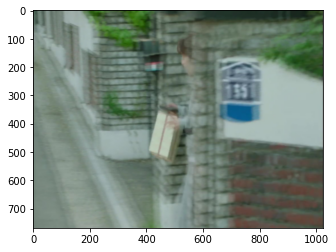

frame.__len__10, mAP_file:AnotherMissOh07_005_0092_IMAGE_0000008450.txt


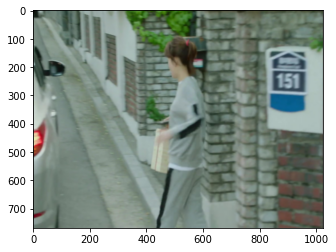

frame.__len__10, mAP_file:AnotherMissOh07_005_0092_IMAGE_0000008458.txt


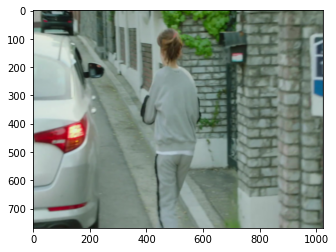

frame.__len__10, mAP_file:AnotherMissOh07_005_0092_IMAGE_0000008466.txt


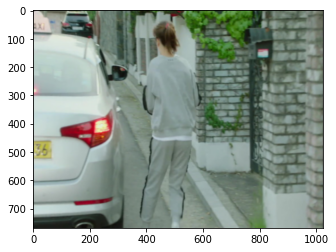

frame.__len__10, mAP_file:AnotherMissOh07_005_0092_IMAGE_0000008474.txt


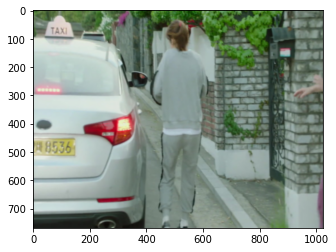

frame.__len__10, mAP_file:AnotherMissOh07_005_0092_IMAGE_0000008482.txt


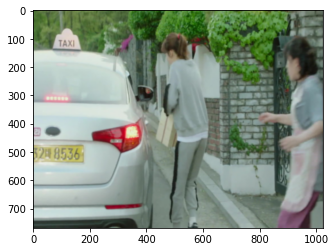

frame.__len__10, mAP_file:AnotherMissOh07_005_0092_IMAGE_0000008490.txt


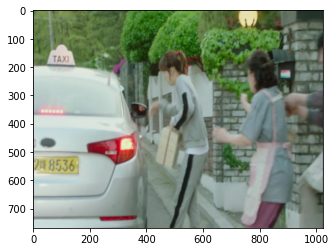

frame.__len__10, mAP_file:AnotherMissOh07_005_0092_IMAGE_0000008498.txt


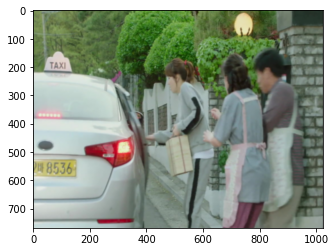

frame.__len__7, mAP_file:AnotherMissOh07_005_0093_IMAGE_0000008542.txt


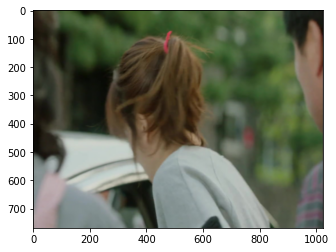

frame.__len__7, mAP_file:AnotherMissOh07_005_0093_IMAGE_0000008550.txt


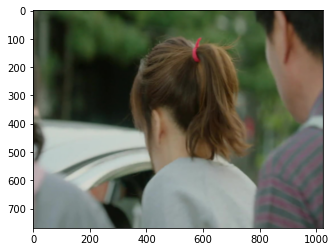

frame.__len__7, mAP_file:AnotherMissOh07_005_0093_IMAGE_0000008558.txt


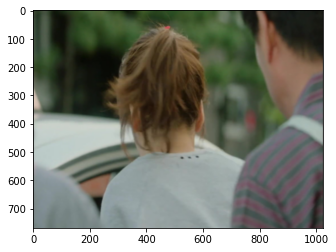

frame.__len__7, mAP_file:AnotherMissOh07_005_0093_IMAGE_0000008566.txt
frame.__len__7, mAP_file:AnotherMissOh07_005_0093_IMAGE_0000008574.txt
frame.__len__7, mAP_file:AnotherMissOh07_005_0093_IMAGE_0000008582.txt
frame.__len__7, mAP_file:AnotherMissOh07_005_0093_IMAGE_0000008590.txt
frame.__len__8, mAP_file:AnotherMissOh07_005_0095_IMAGE_0000008734.txt


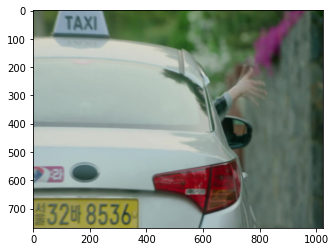

frame.__len__8, mAP_file:AnotherMissOh07_005_0095_IMAGE_0000008742.txt


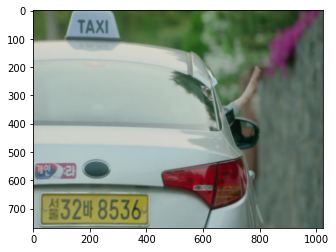

frame.__len__8, mAP_file:AnotherMissOh07_005_0095_IMAGE_0000008750.txt


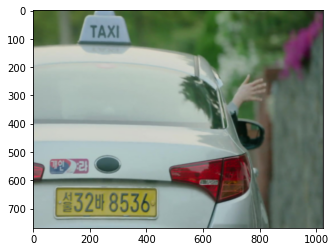

frame.__len__8, mAP_file:AnotherMissOh07_005_0095_IMAGE_0000008758.txt


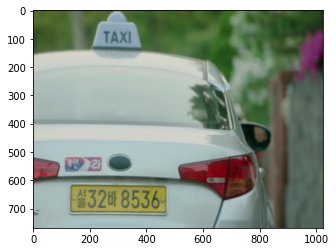

frame.__len__8, mAP_file:AnotherMissOh07_005_0095_IMAGE_0000008766.txt


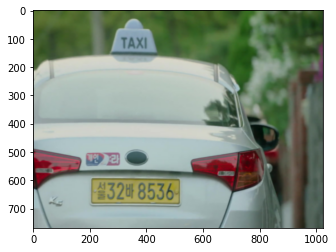

frame.__len__8, mAP_file:AnotherMissOh07_005_0095_IMAGE_0000008774.txt


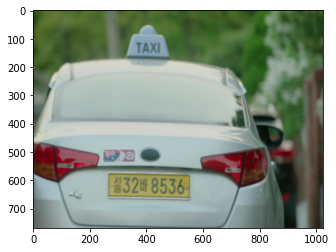

frame.__len__8, mAP_file:AnotherMissOh07_005_0095_IMAGE_0000008782.txt


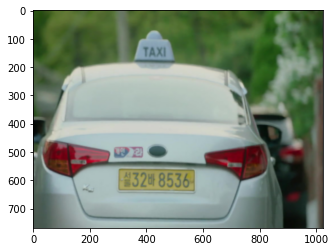

frame.__len__8, mAP_file:AnotherMissOh07_005_0095_IMAGE_0000008790.txt


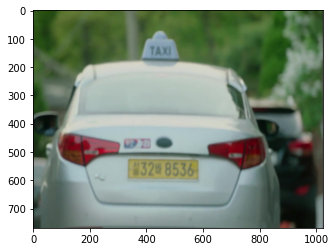

frame.__len__10, mAP_file:AnotherMissOh07_006_0098_IMAGE_0000009091.txt


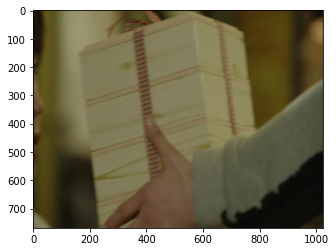

frame.__len__10, mAP_file:AnotherMissOh07_006_0098_IMAGE_0000009099.txt


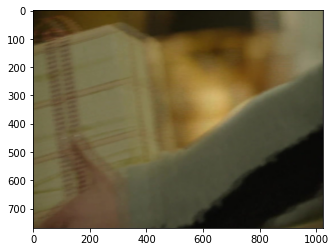

frame.__len__10, mAP_file:AnotherMissOh07_006_0098_IMAGE_0000009107.txt


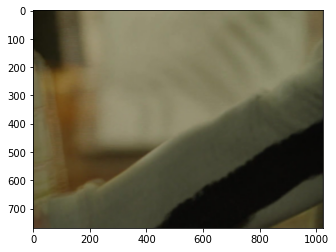

frame.__len__10, mAP_file:AnotherMissOh07_006_0098_IMAGE_0000009115.txt


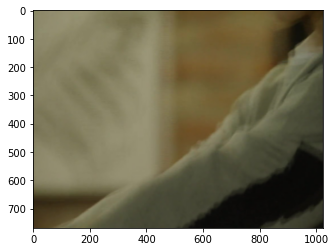

frame.__len__10, mAP_file:AnotherMissOh07_006_0098_IMAGE_0000009123.txt


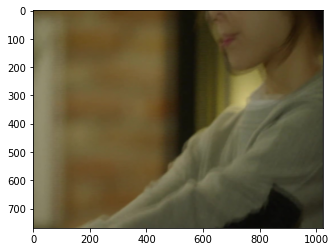

frame.__len__10, mAP_file:AnotherMissOh07_006_0098_IMAGE_0000009131.txt
frame.__len__10, mAP_file:AnotherMissOh07_006_0098_IMAGE_0000009139.txt
frame.__len__10, mAP_file:AnotherMissOh07_006_0098_IMAGE_0000009147.txt
frame.__len__10, mAP_file:AnotherMissOh07_006_0098_IMAGE_0000009155.txt
frame.__len__10, mAP_file:AnotherMissOh07_006_0098_IMAGE_0000009163.txt
frame.__len__10, mAP_file:AnotherMissOh07_006_0106_IMAGE_0000009842.txt


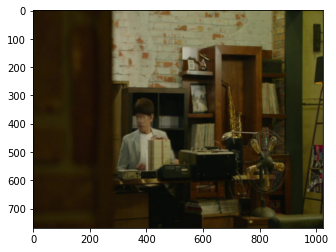

frame.__len__10, mAP_file:AnotherMissOh07_006_0106_IMAGE_0000009850.txt


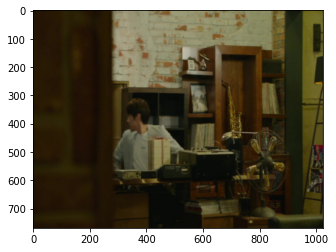

frame.__len__10, mAP_file:AnotherMissOh07_006_0106_IMAGE_0000009858.txt


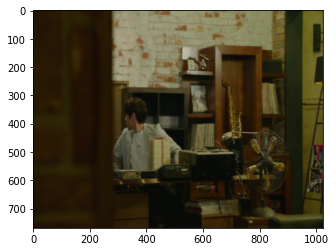

frame.__len__10, mAP_file:AnotherMissOh07_006_0106_IMAGE_0000009866.txt
frame.__len__10, mAP_file:AnotherMissOh07_006_0106_IMAGE_0000009874.txt
frame.__len__10, mAP_file:AnotherMissOh07_006_0106_IMAGE_0000009882.txt
frame.__len__10, mAP_file:AnotherMissOh07_006_0106_IMAGE_0000009890.txt
frame.__len__10, mAP_file:AnotherMissOh07_006_0106_IMAGE_0000009898.txt
frame.__len__10, mAP_file:AnotherMissOh07_006_0106_IMAGE_0000009906.txt
frame.__len__10, mAP_file:AnotherMissOh07_006_0106_IMAGE_0000009914.txt
frame.__len__10, mAP_file:AnotherMissOh07_007_0107_IMAGE_0000010195.txt


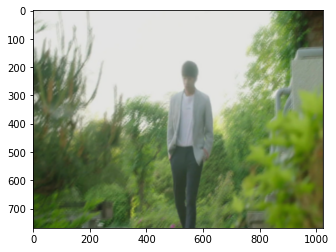

frame.__len__10, mAP_file:AnotherMissOh07_007_0107_IMAGE_0000010203.txt


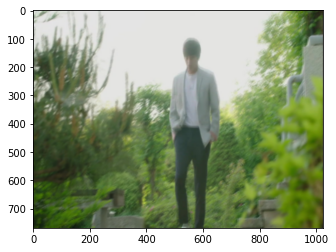

frame.__len__10, mAP_file:AnotherMissOh07_007_0107_IMAGE_0000010211.txt


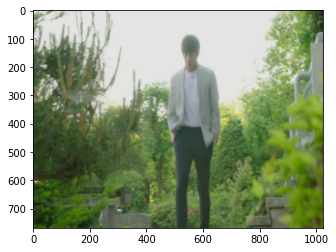

frame.__len__10, mAP_file:AnotherMissOh07_007_0107_IMAGE_0000010219.txt


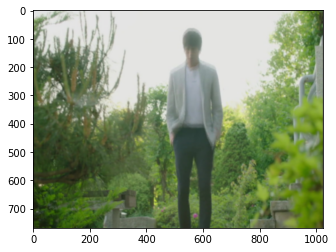

frame.__len__10, mAP_file:AnotherMissOh07_007_0107_IMAGE_0000010227.txt


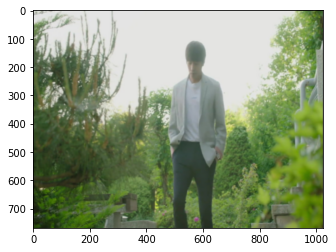

frame.__len__10, mAP_file:AnotherMissOh07_007_0107_IMAGE_0000010235.txt


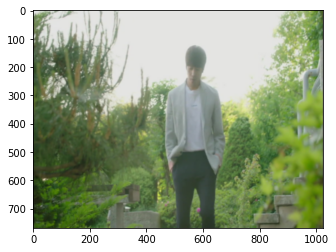

frame.__len__10, mAP_file:AnotherMissOh07_007_0107_IMAGE_0000010243.txt


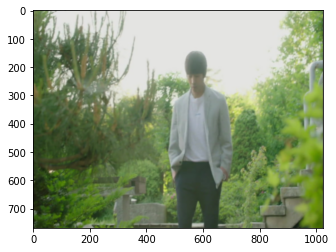

frame.__len__10, mAP_file:AnotherMissOh07_007_0107_IMAGE_0000010251.txt


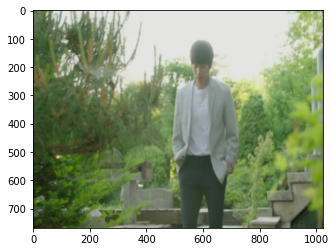

frame.__len__10, mAP_file:AnotherMissOh07_007_0107_IMAGE_0000010259.txt


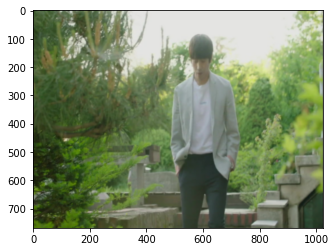

frame.__len__10, mAP_file:AnotherMissOh07_007_0107_IMAGE_0000010267.txt
frame.__len__10, mAP_file:AnotherMissOh07_007_0108_IMAGE_0000010541.txt


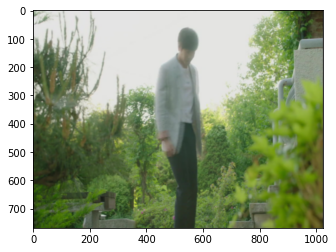

frame.__len__10, mAP_file:AnotherMissOh07_007_0108_IMAGE_0000010549.txt


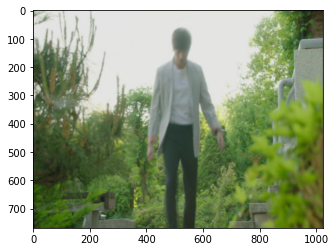

frame.__len__10, mAP_file:AnotherMissOh07_007_0108_IMAGE_0000010557.txt


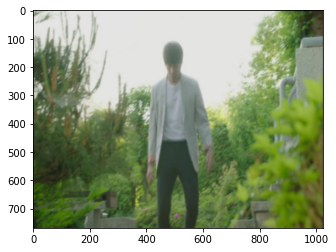

frame.__len__10, mAP_file:AnotherMissOh07_007_0108_IMAGE_0000010565.txt


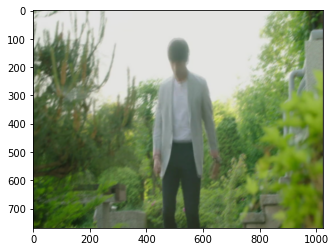

frame.__len__10, mAP_file:AnotherMissOh07_007_0108_IMAGE_0000010573.txt


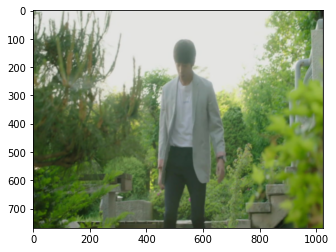

frame.__len__10, mAP_file:AnotherMissOh07_007_0108_IMAGE_0000010581.txt


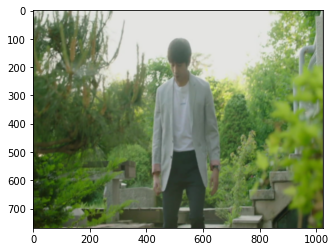

frame.__len__10, mAP_file:AnotherMissOh07_007_0108_IMAGE_0000010589.txt


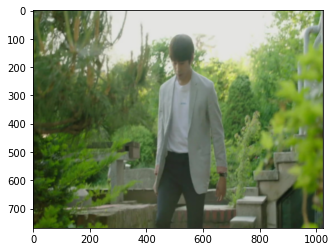

frame.__len__10, mAP_file:AnotherMissOh07_007_0108_IMAGE_0000010597.txt


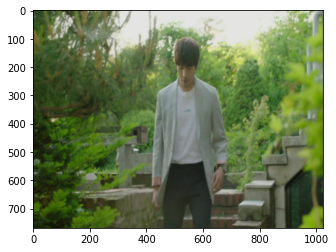

frame.__len__10, mAP_file:AnotherMissOh07_007_0108_IMAGE_0000010605.txt


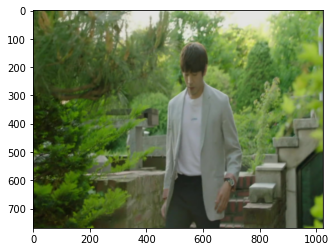

frame.__len__10, mAP_file:AnotherMissOh07_007_0108_IMAGE_0000010613.txt


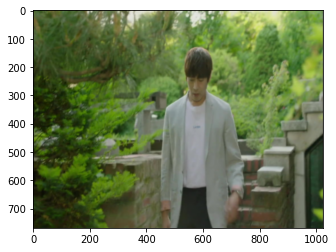

frame.__len__4, mAP_file:AnotherMissOh07_007_0109_IMAGE_0000010901.txt


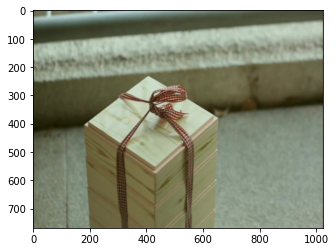

frame.__len__4, mAP_file:AnotherMissOh07_007_0109_IMAGE_0000010909.txt


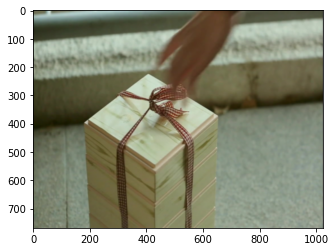

frame.__len__4, mAP_file:AnotherMissOh07_007_0109_IMAGE_0000010917.txt


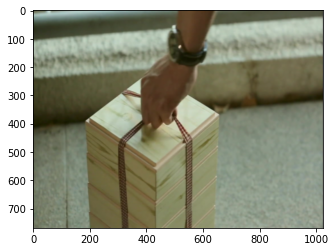

frame.__len__4, mAP_file:AnotherMissOh07_007_0109_IMAGE_0000010925.txt


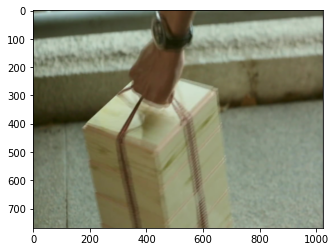

frame.__len__10, mAP_file:AnotherMissOh07_007_0110_IMAGE_0000010931.txt


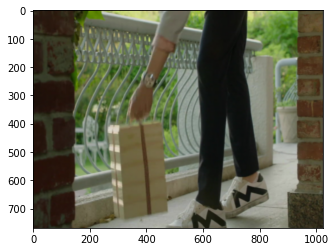

frame.__len__10, mAP_file:AnotherMissOh07_007_0110_IMAGE_0000010939.txt


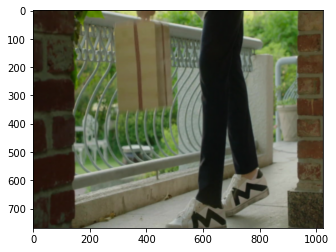

frame.__len__10, mAP_file:AnotherMissOh07_007_0110_IMAGE_0000010947.txt


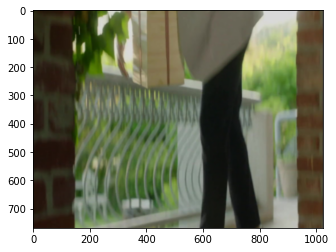

frame.__len__10, mAP_file:AnotherMissOh07_007_0110_IMAGE_0000010955.txt


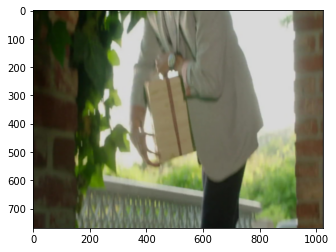

frame.__len__10, mAP_file:AnotherMissOh07_007_0110_IMAGE_0000010963.txt


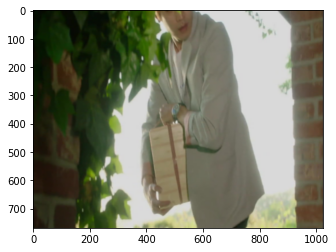

frame.__len__10, mAP_file:AnotherMissOh07_007_0110_IMAGE_0000010971.txt


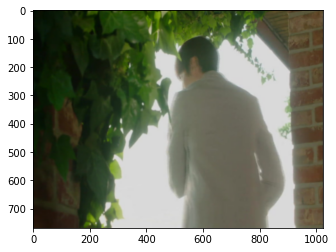

frame.__len__10, mAP_file:AnotherMissOh07_007_0110_IMAGE_0000010979.txt
frame.__len__10, mAP_file:AnotherMissOh07_007_0110_IMAGE_0000010987.txt
frame.__len__10, mAP_file:AnotherMissOh07_007_0110_IMAGE_0000010995.txt
frame.__len__10, mAP_file:AnotherMissOh07_007_0110_IMAGE_0000011003.txt
frame.__len__10, mAP_file:AnotherMissOh07_007_0111_IMAGE_0000011048.txt


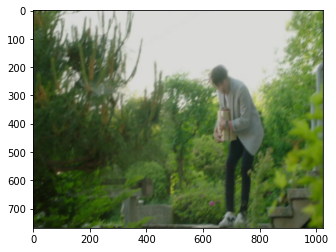

frame.__len__10, mAP_file:AnotherMissOh07_007_0111_IMAGE_0000011056.txt
frame.__len__10, mAP_file:AnotherMissOh07_007_0111_IMAGE_0000011064.txt
frame.__len__10, mAP_file:AnotherMissOh07_007_0111_IMAGE_0000011072.txt
frame.__len__10, mAP_file:AnotherMissOh07_007_0111_IMAGE_0000011080.txt
frame.__len__10, mAP_file:AnotherMissOh07_007_0111_IMAGE_0000011088.txt
frame.__len__10, mAP_file:AnotherMissOh07_007_0111_IMAGE_0000011096.txt
frame.__len__10, mAP_file:AnotherMissOh07_007_0111_IMAGE_0000011104.txt
frame.__len__10, mAP_file:AnotherMissOh07_007_0111_IMAGE_0000011112.txt
frame.__len__10, mAP_file:AnotherMissOh07_007_0111_IMAGE_0000011120.txt
frame.__len__10, mAP_file:AnotherMissOh07_007_0112_IMAGE_0000011458.txt


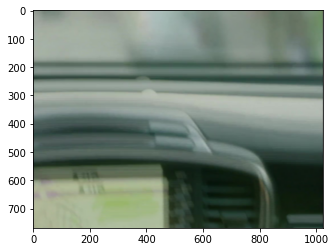

frame.__len__10, mAP_file:AnotherMissOh07_007_0112_IMAGE_0000011466.txt


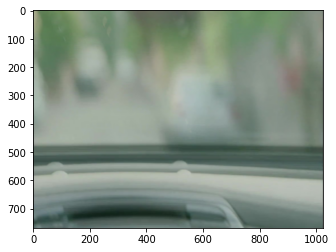

frame.__len__10, mAP_file:AnotherMissOh07_007_0112_IMAGE_0000011490.txt


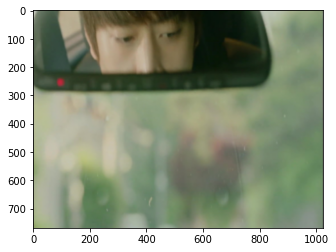

frame.__len__10, mAP_file:AnotherMissOh07_007_0112_IMAGE_0000011498.txt


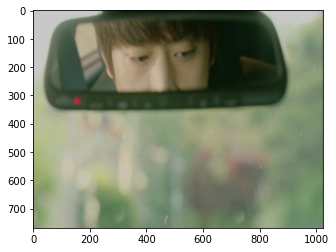

frame.__len__10, mAP_file:AnotherMissOh07_007_0112_IMAGE_0000011506.txt


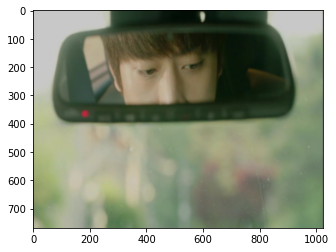

frame.__len__10, mAP_file:AnotherMissOh07_007_0112_IMAGE_0000011514.txt


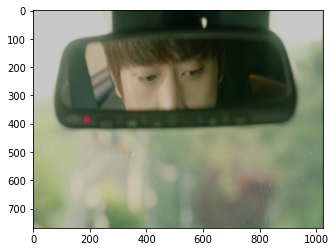

frame.__len__10, mAP_file:AnotherMissOh07_007_0112_IMAGE_0000011522.txt


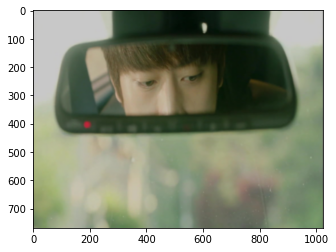

frame.__len__10, mAP_file:AnotherMissOh07_007_0112_IMAGE_0000011530.txt


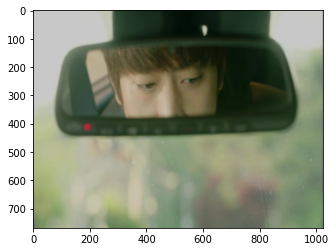

frame.__len__10, mAP_file:AnotherMissOh07_007_0112_IMAGE_0000011538.txt


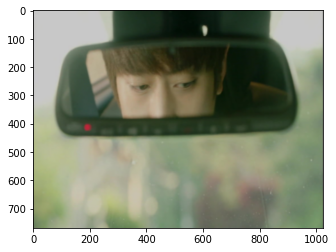

frame.__len__10, mAP_file:AnotherMissOh07_007_0112_IMAGE_0000011546.txt


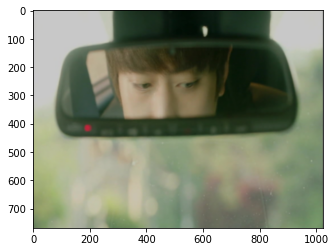

frame.__len__10, mAP_file:AnotherMissOh07_008_0116_IMAGE_0000012384.txt


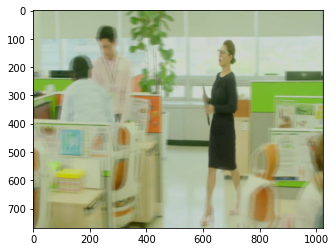

frame.__len__10, mAP_file:AnotherMissOh07_008_0116_IMAGE_0000012392.txt


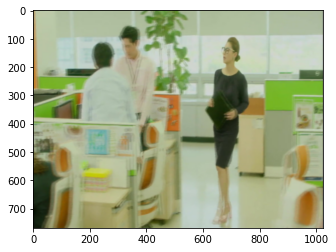

frame.__len__10, mAP_file:AnotherMissOh07_008_0116_IMAGE_0000012400.txt


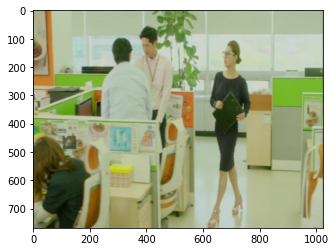

frame.__len__10, mAP_file:AnotherMissOh07_008_0116_IMAGE_0000012408.txt
frame.__len__10, mAP_file:AnotherMissOh07_008_0116_IMAGE_0000012416.txt
frame.__len__10, mAP_file:AnotherMissOh07_008_0116_IMAGE_0000012424.txt
frame.__len__10, mAP_file:AnotherMissOh07_008_0116_IMAGE_0000012432.txt
frame.__len__10, mAP_file:AnotherMissOh07_008_0116_IMAGE_0000012440.txt
frame.__len__10, mAP_file:AnotherMissOh07_008_0116_IMAGE_0000012448.txt
frame.__len__10, mAP_file:AnotherMissOh07_008_0116_IMAGE_0000012456.txt
frame.__len__7, mAP_file:AnotherMissOh07_008_0117_IMAGE_0000012499.txt


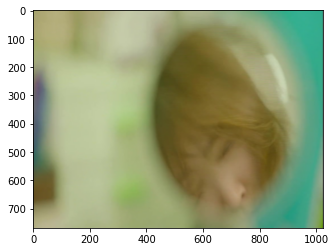

frame.__len__7, mAP_file:AnotherMissOh07_008_0117_IMAGE_0000012507.txt
frame.__len__7, mAP_file:AnotherMissOh07_008_0117_IMAGE_0000012515.txt
frame.__len__7, mAP_file:AnotherMissOh07_008_0117_IMAGE_0000012523.txt
frame.__len__7, mAP_file:AnotherMissOh07_008_0117_IMAGE_0000012531.txt
frame.__len__7, mAP_file:AnotherMissOh07_008_0117_IMAGE_0000012539.txt
frame.__len__7, mAP_file:AnotherMissOh07_008_0117_IMAGE_0000012547.txt
frame.__len__1, mAP_file:AnotherMissOh07_008_0118_IMAGE_0000012553.txt


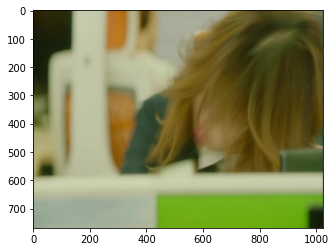

frame.__len__2, mAP_file:AnotherMissOh07_008_0119_IMAGE_0000012566.txt


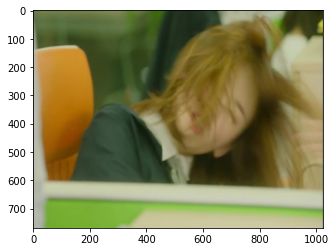

frame.__len__2, mAP_file:AnotherMissOh07_008_0119_IMAGE_0000012574.txt


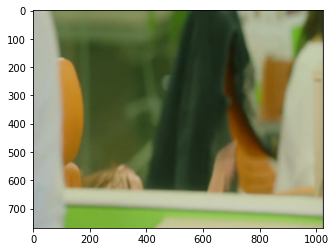

frame.__len__7, mAP_file:AnotherMissOh07_008_0125_IMAGE_0000012846.txt
person_pred:Jinsang 0.4868278205394745 116 42 667 707

detected ./results/drama-graph/AnotherMissOh07/008/0125/IMAGE_0000012846.jpg
person_pred:Haeyoung1 0.3995954692363739 521 327 1004 706

detected ./results/drama-graph/AnotherMissOh07/008/0125/IMAGE_0000012846.jpg
non-detected ./results/drama-graph/AnotherMissOh07/008/0125/IMAGE_0000012846.jpg


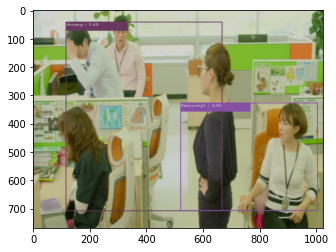

frame.__len__7, mAP_file:AnotherMissOh07_008_0125_IMAGE_0000012854.txt
person_pred:Jinsang 0.451649010181427 121 16 663 703

detected ./results/drama-graph/AnotherMissOh07/008/0125/IMAGE_0000012854.jpg
non-detected ./results/drama-graph/AnotherMissOh07/008/0125/IMAGE_0000012854.jpg


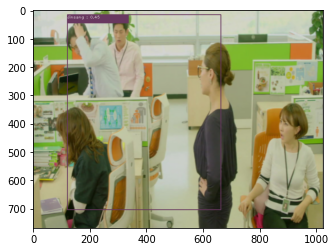

frame.__len__7, mAP_file:AnotherMissOh07_008_0125_IMAGE_0000012862.txt
frame.__len__7, mAP_file:AnotherMissOh07_008_0125_IMAGE_0000012870.txt
frame.__len__7, mAP_file:AnotherMissOh07_008_0125_IMAGE_0000012878.txt
frame.__len__7, mAP_file:AnotherMissOh07_008_0125_IMAGE_0000012886.txt
frame.__len__7, mAP_file:AnotherMissOh07_008_0125_IMAGE_0000012894.txt
frame.__len__3, mAP_file:AnotherMissOh07_008_0129_IMAGE_0000013009.txt
person_pred:Jinsang 0.4570755958557129 438 32 933 696

detected ./results/drama-graph/AnotherMissOh07/008/0129/IMAGE_0000013009.jpg
non-detected ./results/drama-graph/AnotherMissOh07/008/0129/IMAGE_0000013009.jpg


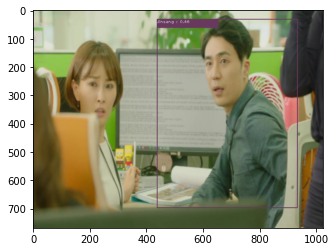

frame.__len__3, mAP_file:AnotherMissOh07_008_0129_IMAGE_0000013017.txt
person_pred:Jinsang 0.6148905754089355 450 36 909 688

detected ./results/drama-graph/AnotherMissOh07/008/0129/IMAGE_0000013017.jpg
non-detected ./results/drama-graph/AnotherMissOh07/008/0129/IMAGE_0000013017.jpg


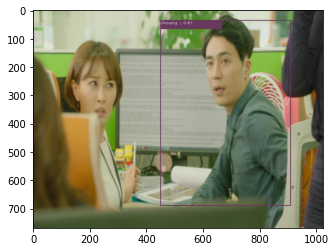

frame.__len__3, mAP_file:AnotherMissOh07_008_0129_IMAGE_0000013025.txt
person_pred:Jinsang 0.7099653482437134 449 27 907 708

detected ./results/drama-graph/AnotherMissOh07/008/0129/IMAGE_0000013025.jpg
non-detected ./results/drama-graph/AnotherMissOh07/008/0129/IMAGE_0000013025.jpg


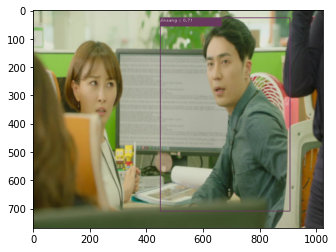

frame.__len__10, mAP_file:AnotherMissOh07_008_0132_IMAGE_0000013185.txt


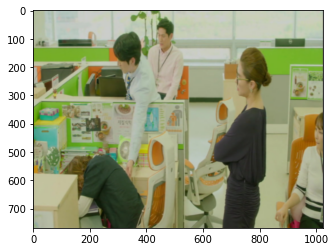

frame.__len__10, mAP_file:AnotherMissOh07_008_0132_IMAGE_0000013193.txt


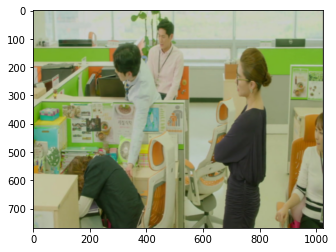

frame.__len__10, mAP_file:AnotherMissOh07_008_0132_IMAGE_0000013201.txt
frame.__len__10, mAP_file:AnotherMissOh07_008_0132_IMAGE_0000013209.txt
frame.__len__10, mAP_file:AnotherMissOh07_008_0132_IMAGE_0000013217.txt
frame.__len__10, mAP_file:AnotherMissOh07_008_0132_IMAGE_0000013225.txt
frame.__len__10, mAP_file:AnotherMissOh07_008_0132_IMAGE_0000013233.txt
frame.__len__10, mAP_file:AnotherMissOh07_008_0132_IMAGE_0000013241.txt
frame.__len__10, mAP_file:AnotherMissOh07_008_0132_IMAGE_0000013249.txt
frame.__len__10, mAP_file:AnotherMissOh07_008_0132_IMAGE_0000013257.txt
frame.__len__8, mAP_file:AnotherMissOh07_008_0133_IMAGE_0000013275.txt


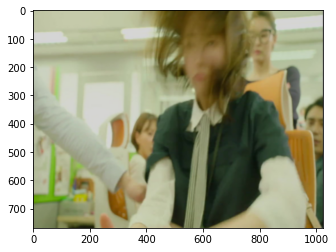

frame.__len__8, mAP_file:AnotherMissOh07_008_0133_IMAGE_0000013283.txt
frame.__len__8, mAP_file:AnotherMissOh07_008_0133_IMAGE_0000013291.txt
frame.__len__8, mAP_file:AnotherMissOh07_008_0133_IMAGE_0000013299.txt
frame.__len__8, mAP_file:AnotherMissOh07_008_0133_IMAGE_0000013307.txt
frame.__len__8, mAP_file:AnotherMissOh07_008_0133_IMAGE_0000013315.txt
frame.__len__8, mAP_file:AnotherMissOh07_008_0133_IMAGE_0000013323.txt
frame.__len__8, mAP_file:AnotherMissOh07_008_0133_IMAGE_0000013331.txt
frame.__len__5, mAP_file:AnotherMissOh07_008_0139_IMAGE_0000013621.txt


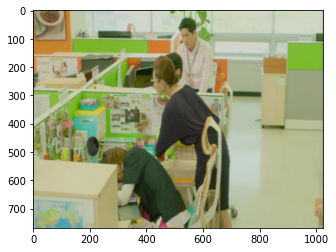

frame.__len__5, mAP_file:AnotherMissOh07_008_0139_IMAGE_0000013629.txt
frame.__len__5, mAP_file:AnotherMissOh07_008_0139_IMAGE_0000013637.txt
frame.__len__5, mAP_file:AnotherMissOh07_008_0139_IMAGE_0000013645.txt
frame.__len__5, mAP_file:AnotherMissOh07_008_0139_IMAGE_0000013653.txt
frame.__len__10, mAP_file:AnotherMissOh07_008_0142_IMAGE_0000013906.txt


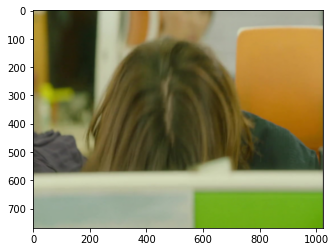

frame.__len__10, mAP_file:AnotherMissOh07_008_0142_IMAGE_0000013914.txt


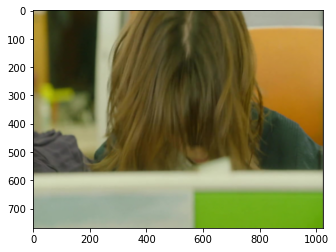

frame.__len__10, mAP_file:AnotherMissOh07_008_0142_IMAGE_0000013922.txt


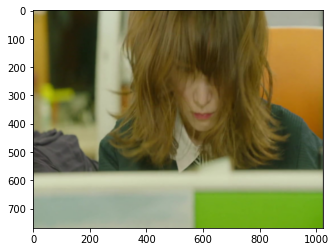

frame.__len__10, mAP_file:AnotherMissOh07_008_0142_IMAGE_0000013930.txt
frame.__len__10, mAP_file:AnotherMissOh07_008_0142_IMAGE_0000013938.txt
frame.__len__10, mAP_file:AnotherMissOh07_008_0142_IMAGE_0000013946.txt
frame.__len__10, mAP_file:AnotherMissOh07_008_0142_IMAGE_0000013954.txt
frame.__len__10, mAP_file:AnotherMissOh07_008_0142_IMAGE_0000013962.txt
frame.__len__10, mAP_file:AnotherMissOh07_008_0142_IMAGE_0000013970.txt
frame.__len__10, mAP_file:AnotherMissOh07_008_0142_IMAGE_0000013978.txt
frame.__len__9, mAP_file:AnotherMissOh07_008_0145_IMAGE_0000014134.txt


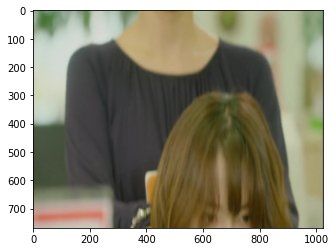

frame.__len__9, mAP_file:AnotherMissOh07_008_0145_IMAGE_0000014142.txt


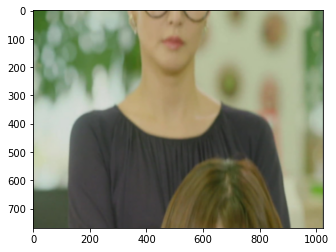

frame.__len__9, mAP_file:AnotherMissOh07_008_0145_IMAGE_0000014150.txt
frame.__len__9, mAP_file:AnotherMissOh07_008_0145_IMAGE_0000014158.txt
frame.__len__9, mAP_file:AnotherMissOh07_008_0145_IMAGE_0000014166.txt
frame.__len__9, mAP_file:AnotherMissOh07_008_0145_IMAGE_0000014174.txt
frame.__len__9, mAP_file:AnotherMissOh07_008_0145_IMAGE_0000014182.txt
frame.__len__9, mAP_file:AnotherMissOh07_008_0145_IMAGE_0000014190.txt
frame.__len__9, mAP_file:AnotherMissOh07_008_0145_IMAGE_0000014198.txt
frame.__len__3, mAP_file:AnotherMissOh07_008_0147_IMAGE_0000014234.txt
person_pred:Jinsang 0.9186859726905823 506 19 1024 738

detected ./results/drama-graph/AnotherMissOh07/008/0147/IMAGE_0000014234.jpg
non-detected ./results/drama-graph/AnotherMissOh07/008/0147/IMAGE_0000014234.jpg


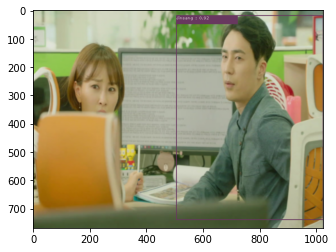

frame.__len__3, mAP_file:AnotherMissOh07_008_0147_IMAGE_0000014242.txt
person_pred:Jinsang 0.7864408493041992 511 32 1024 717

detected ./results/drama-graph/AnotherMissOh07/008/0147/IMAGE_0000014242.jpg
non-detected ./results/drama-graph/AnotherMissOh07/008/0147/IMAGE_0000014242.jpg


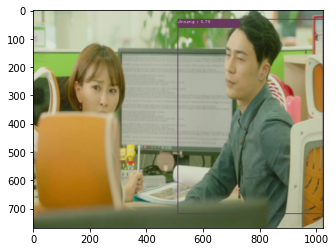

frame.__len__3, mAP_file:AnotherMissOh07_008_0147_IMAGE_0000014250.txt
person_pred:Jinsang 0.7877164483070374 515 20 1017 749

detected ./results/drama-graph/AnotherMissOh07/008/0147/IMAGE_0000014250.jpg
non-detected ./results/drama-graph/AnotherMissOh07/008/0147/IMAGE_0000014250.jpg


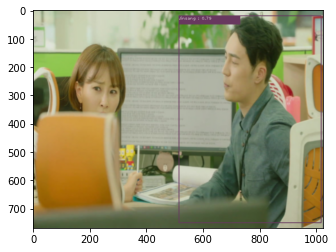

In [ ]:
# Sequence buffers
buffer_images = []
# load test clips
for iter, batch in enumerate(test_loader):
    image, info = batch

    # sort label info on fullrect
    image, label, behavior_label, obj_label, face_label, emo_label, frame_id = SortFullRect(
        image, info, is_train=False)
    try :
        image = torch.cat(image,0).cuda(device)
    except:
        continue
        
    # -----------------(2) inference -------------------------
    # logits : [1, 125, 14, 14]
    # behavior_logits : [1, 135, 14, 14]
    if Behavior:
        predictions_p, b_logits = model1(image, label, behavior_label)
    else:
        # person and behavior predictions
        # logits : [1, 125, 14, 14]
        p_logits, _ = model_p(image)
        predictions_p = post_processing(p_logits,opt.image_size,PersonCLS,model_p.detector.anchors,
                                        opt.conf_threshold,opt.nms_threshold)
        
    for idx, frame in enumerate(frame_id):

        # ---------------(3) mkdir for evaluations----------------------
        f_info = frame[0].split('/')
        save_dir = './results/drama-graph/{}/{}/{}/'.format(
            f_info[4], f_info[5], f_info[6])

        f_file = f_info[7]
        mAP_file = "{}_{}_{}_{}".format(f_info[4],f_info[5],f_info[6],f_info[7].replace("jpg", "txt"))
        if opt.display:
            print("frame.__len__{}, mAP_file:{}".format(len(frame_id), mAP_file))
        # --------------(5) visualization of inferences ----------
        # out of try : pdb.set_trace = lambda : None
        try:
            # for some empty video clips
            img = image[idx]
            # ToTensor function normalizes image pixel values into [0,1]
            np_img = img.cpu().numpy()
            np_img = np.transpose(np_img,(1,2,0)) * 255
            output_image = cv2.cvtColor(np_img,cv2.COLOR_RGB2BGR)
            output_image = cv2.resize(output_image, (width, height))
            if len(predictions_p) != 0 :
                prediction = predictions_p[idx]
                if Behavior:
                    b_logit = b_logits[idx]

                # person and behavior
                num_preds = len(prediction)
                for jdx, pred in enumerate(prediction):
                    # person
                    xmin = int(max(pred[0] / width_ratio, 0))
                    ymin = int(max(pred[1] / height_ratio, 0))
                    xmax = int(min((pred[2]) / width_ratio, width))
                    ymax = int(min((pred[3]) / height_ratio, height))
                    color = colors[PersonCLS.index(pred[5])]

                    cv2.rectangle(output_image, (xmin, ymin),(xmax, ymax), color, 2)
                    text_size = cv2.getTextSize(pred[5] + ' : %.2f' % pred[4],
                                                cv2.FONT_HERSHEY_PLAIN, 1, 1)[0]
                    cv2.rectangle(output_image,(xmin, ymin),(xmin + text_size[0] + 100,
                         ymin + text_size[1] + 20), color, -1)
                    cv2.putText(output_image, pred[5] + ' : %.2f' % pred[4],
                        (xmin, ymin + text_size[1] + 4),
                        cv2.FONT_HERSHEY_PLAIN, 1,
                        (255, 255, 255), 1)
                        
                    pred_cls = pred[5]
                    cat_pred = '%s %s %s %s %s %s\n' % (pred_cls,str(pred[4]),
                        str(xmin), str(ymin), str(xmax), str(ymax))
                    print("person_pred:{}".format(cat_pred))
                    
                    # behavior
                    if Behavior:
                        value, index = b_logit[jdx].max(0)

                        b_idx = index.cpu().numpy()
                        b_pred = PBeHavCLS[b_idx]
                        
                        cv2.putText(output_image, '+ behavior : ' + b_pred,
                            (xmin, ymin + text_size[1] + 4 + 12),
                            cv2.FONT_HERSHEY_PLAIN, 1,
                            (255, 255, 255), 1)
                        pred_beh_cls = b_pred.replace(' ', '_')
                        pred_beh_cls = pred_beh_cls.replace('/', '_')
                        
                        cat_pred_beh = '%s %s %s %s %s %s\n' % (pred_beh_cls,str(pred[4]),
                            str(xmin), str(ymin), str(xmax), str(ymax))
                        
                        print("behavior_pred:{}".format(cat_pred_beh))
                    
                    if opt.display:
                        print("detected {}".format(save_dir + "{}".format(f_file)))
                else:
                    if opt.display:
                        print("non-detected {}".format(
                        save_dir + "{}".format(f_file)))

            # save output image  
            cv2.imwrite(save_dir + "{}".format(f_file), output_image)
            # save images
            plt_output_image = cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB)
            plt.imshow(plt_output_image.astype('uint8'))
            plt.show()
            plt.close()
        except:
            continue